# 📥 1. Importation des librairies

In [233]:
import os
import cv2
import glob
import time
import warnings
import itertools
import visualkeras
import pandas as pd
import numpy  as np
from PIL import Image
import seaborn as sns
import tensorflow as tf
import geopandas as gpd
from PIL import ImageFile
from random import randint
import plotly.express as px
import tensorflow_addons as tfa
import matplotlib.pyplot as plt
from collections import Counter
from scipy.ndimage import rotate
from keras.models import load_model
from tensorflow.keras import layers
from sklearn.utils import class_weight
from tensorflow.keras import regularizers
from tensorflow.keras.layers import Dense
from tensorflow.keras.models import Model
from tensorflow.keras.utils import plot_model
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import train_test_split
from sklearn.metrics import multilabel_confusion_matrix
from tensorflow.keras.preprocessing.image import load_img
from tensorflow.keras.callbacks import Callback, EarlyStopping
from sklearn.metrics import confusion_matrix, classification_report
from tensorflow.keras.preprocessing.image import ImageDataGenerator

#from keras.preprocessing.image import ImageDataGenerator
warnings.filterwarnings('ignore')
%matplotlib inline
ImageFile.LOAD_TRUNCATED_IMAGES = True

## Setting up general parameters

In [2]:
# General parameters
epochs = 15
pic_size = 120#240
np.random.seed(42)
tf.random.set_seed(42)

# 🗃️ 2. Chargement du Dataset

## 2.1 Méthode 1 : Sous forme de Numpy Array

In [3]:
folder_path = "./input/fire_prediction_images_no_yes"
no_images = os.listdir(folder_path + '/no/')
yes_images = os.listdir(folder_path + '/yes/')
dataset=[]
lab=[]

for image_name in no_images:
    image=cv2.imread(folder_path + '/no/' + image_name)
    image=Image.fromarray(image,'RGB')
    image=image.resize((120,120))#240,240
    dataset.append(np.array(image))
    lab.append(0)
    
for image_name in yes_images:
    image=cv2.imread(folder_path + '/yes/' + image_name)
    image=Image.fromarray(image,'RGB')
    image=image.resize((120,120))#240,240
    dataset.append(np.array(image))
    lab.append(1)

In [4]:
dataset = np.array(dataset)
lab = np.array(lab)
print(dataset.shape, lab.shape)

(42850, 120, 120, 3) (42850,)


## 2.2 Méthode 2 : Sous forme de DataFrame

In [5]:
path = './input/fire_prediction_images_no_yes'
path_imgs = list(glob.glob(path+'/**/*.jpg'))

In [6]:
labels = list(map(lambda x:os.path.split(os.path.split(x)[0])[1], path_imgs))
file_path = pd.Series(path_imgs, name='File_Path').astype(str)
labels = pd.Series(labels, name='Labels')
data = pd.concat([file_path, labels], axis=1)
data = data.sample(frac=1).reset_index(drop=True)
data.head()

,File_Path,Labels
0,./input/fire_prediction_images_no_yes\yes\-79....,yes
1,./input/fire_prediction_images_no_yes\no\-73.5...,no
2,./input/fire_prediction_images_no_yes\yes\-72....,yes
3,./input/fire_prediction_images_no_yes\yes\-72....,yes
4,./input/fire_prediction_images_no_yes\yes\-78....,yes


# 🔥 3. Analyse des données (EDA)

## 3.1 Echantillons

In [7]:
def plot_state(state):
    plt.figure(figsize= (12,12))
    for i in range(1, 10, 1):
        plt.subplot(3,3,i)
        img = load_img(folder_path + "/" + state + "/" + os.listdir(folder_path + "/" + state)[i], target_size=(pic_size, pic_size))
        plt.imshow(img)   
    plt.show()

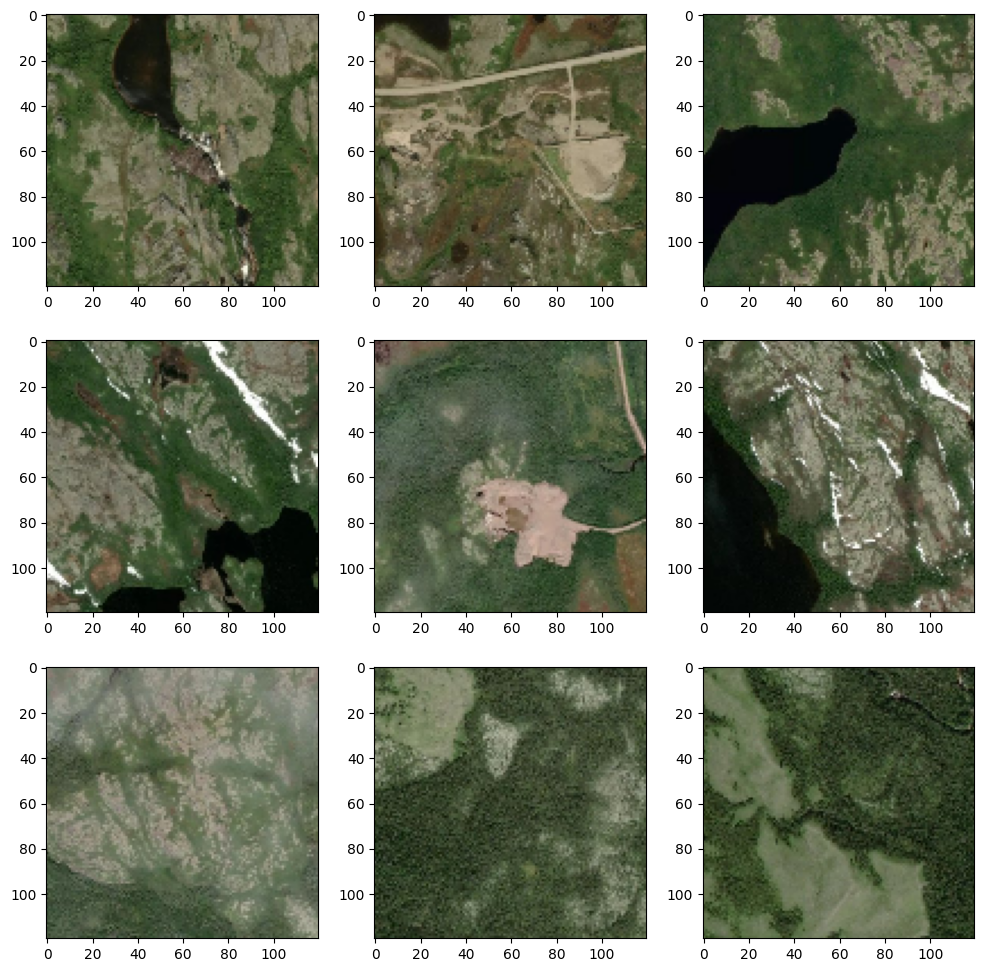

In [8]:
plot_state('yes')

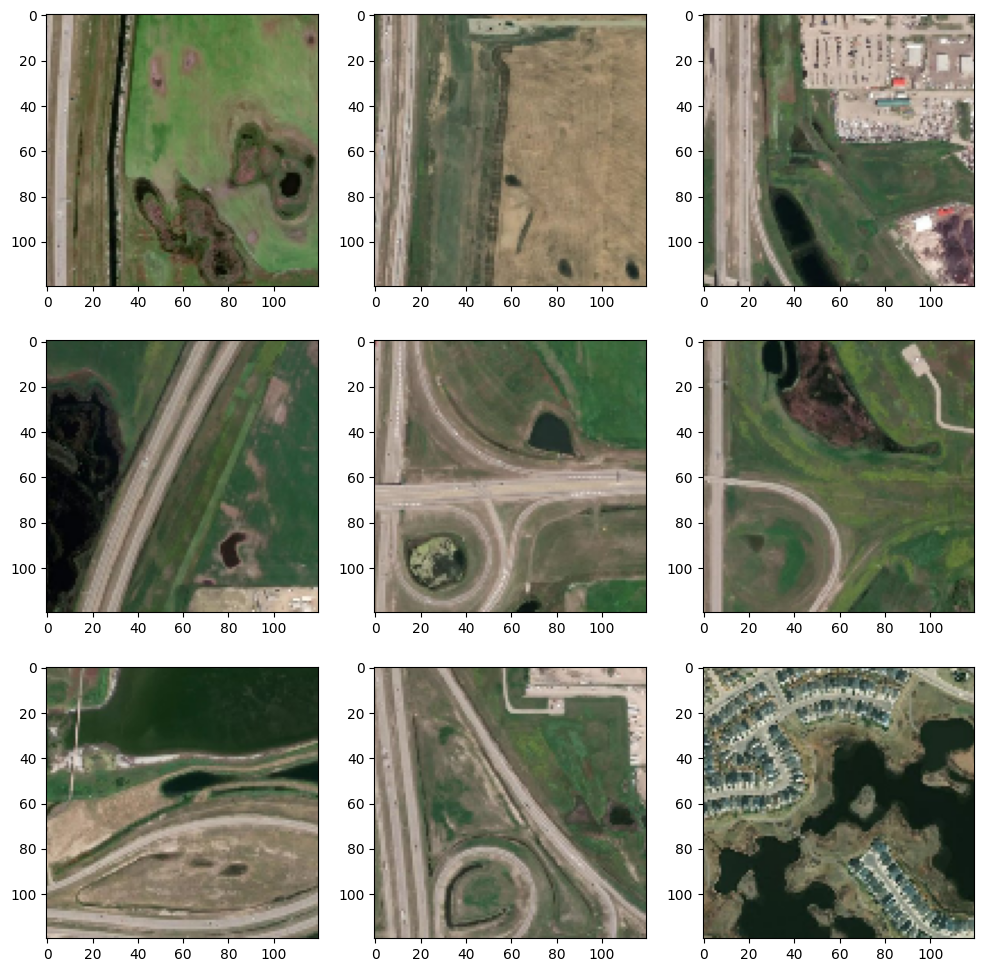

In [9]:
plot_state("no")

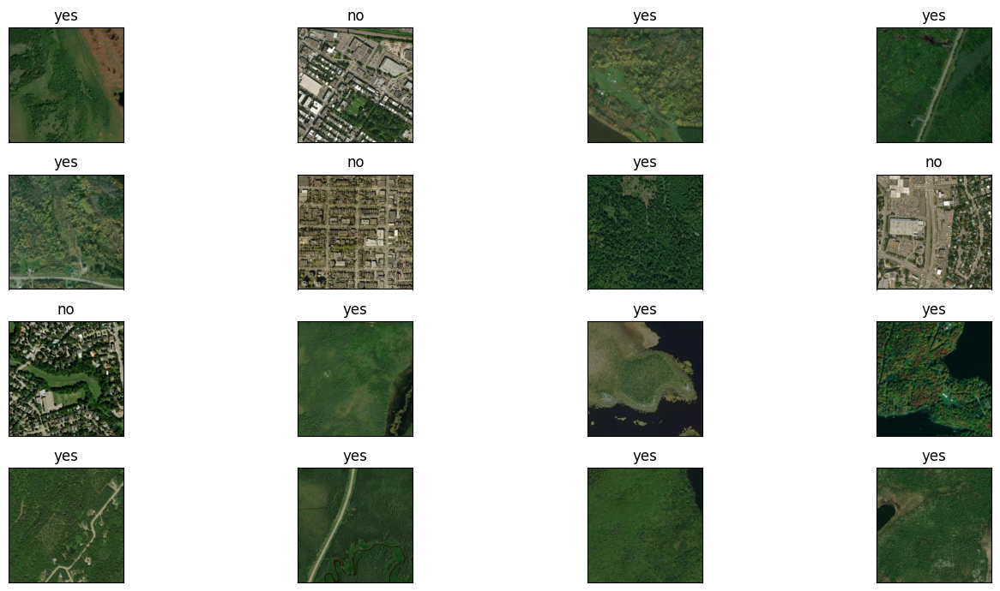

In [10]:
fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(15, 7),
                        subplot_kw={'xticks': [], 'yticks': []})
for i, ax in enumerate(axes.flat):
    ax.imshow(plt.imread(data.File_Path[i]))
    ax.set_title(data.Labels[i])
plt.tight_layout()
plt.show()

## 3.2 Proportions

[Text(0, 0, '22710'), Text(0, 0, '20140')]

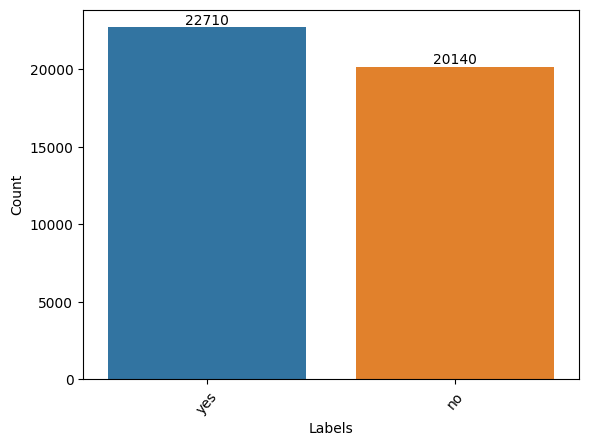

In [11]:
counts = data.Labels.value_counts(normalize=False)
ax = sns.barplot(x=counts.index, y=counts)
plt.xlabel('Labels')
plt.ylabel('Count')
plt.xticks(rotation=50);
ax.bar_label(ax.containers[0], fmt='%.0f')

[Text(0, 0, '0.53'), Text(0, 0, '0.47')]

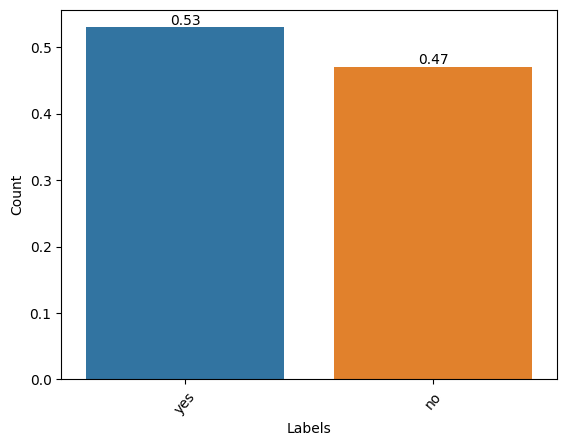

In [12]:
counts = data.Labels.value_counts(normalize=True)
ax = sns.barplot(x=counts.index, y=counts)
plt.xlabel('Labels')
plt.ylabel('Count')
plt.xticks(rotation=50);
ax.bar_label(ax.containers[0], fmt='%.2f')

## 3.3 Positionnement géographique des photos

In [13]:
df_lt_lg=data[["File_Path"]].copy()

#Création d'une colonne File_Name
df_lt_lg["File_Name"]=np.nan
for index in df_lt_lg.index:
    df_lt_lg.loc[index, 'File_Name']=os.path.basename(df_lt_lg.loc[index, 'File_Path'])

#Création d'une colonne latlong
df_lt_lg["Lat_Long"]=np.nan
df_lt_lg["Lat_Long"]=df_lt_lg["File_Name"].replace(".jpg","", regex=True)
df_lt_lg.head()

#Séparation des latitudes et longitudes
df_geo = df_lt_lg["Lat_Long"].str.split(',', expand=True)

#Remarque : invertion latitude/longitude par Streamlite
df_geo.rename(columns={0: "longitude", 1: "latitude"}, inplace=True)
df_geo=df_geo.astype('float')

#Ajout des labels
df_geo = pd.concat([df_geo, data["Labels"]], axis=1)

#Remplacement des labels par des codes couleurs

df_geo=df_geo.replace({"yes":"#FA3E0C","no":"#17FA2B"}) 

        
df_geo.to_csv("./Streamlit/df_geo.csv",index= False)

df_geo.rename(columns={"longitude": "latitude", "latitude": "longitude"}, inplace=True)


df_geo.head()


,latitude,longitude,Labels
0,-79.110010,50.583330,#FA3E0C
1,-73.568289,45.538408,#17FA2B
2,-72.391920,46.322850,#FA3E0C
3,-72.606350,46.698140,#FA3E0C
4,-78.982400,48.362110,#FA3E0C


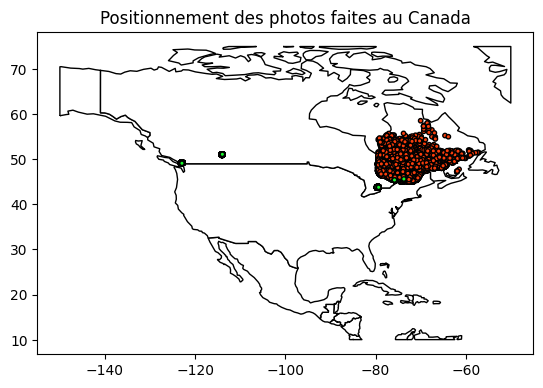

In [14]:
# Création d'une carte du monde avec la position GPS des points fournies dans le dataframe

geo_df = gpd.GeoDataFrame(df_geo, geometry=gpd.points_from_xy(df_geo.latitude, df_geo.longitude))

world = gpd.read_file(gpd.datasets.get_path("naturalearth_lowres"))

# Affichage de la zone voulu (Canada)
ax = world.clip([-150, 10, -50, 75]).plot(color="white", edgecolor="black")

# Affichage de la carte
geo_df.plot(ax=ax,  marker="o", color=geo_df["Labels"], edgecolor="black", markersize=10)
ax.set_title("Positionnement des photos faites au Canada")
plt.show()


## 3.4 Quelques transformations

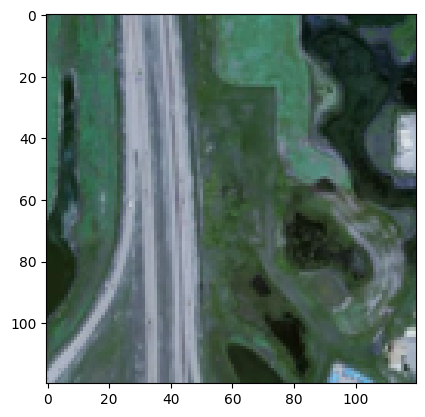

In [236]:
plt.imshow(dataset[0])

### 3.4.1 Rotation

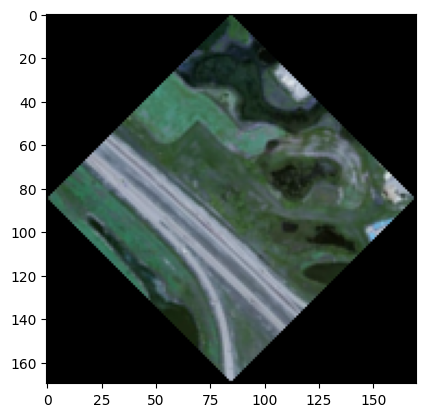

In [245]:
rotate_img = rotate(dataset[0], 45)
plt.imshow(rotate_img)

### 3.4.2 Zoom

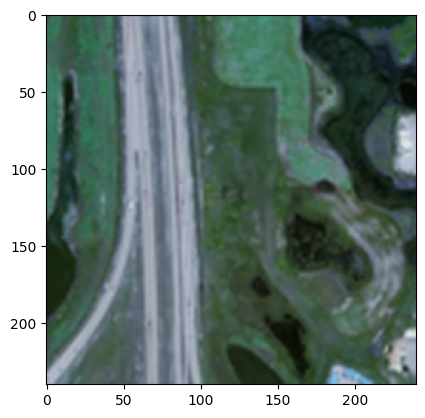

In [269]:
# Création d'un image PILLOW à partir de l'image en array
pil_image = Image.fromarray(np.uint8(dataset[0]))

#Facteur pour zoomer
zoom_factor = 2

# Calcul de la nouvelle dimension
new_width = dataset[0].shape[1] * zoom_factor
new_height = dataset[0].shape[0] * zoom_factor

# Resize avec Pilow pour garder le nombre de channel identique (3)
zoomed_pil_image = pil_image.resize((new_width, new_height), Image.ANTIALIAS)

# Convertion du zoom en array
zoomed_image = np.array(zoomed_pil_image)

plt.imshow(zoomed_image)

#Remarque : l'utilisation de scipy.ndimage.zoom ne permet pas de maintenir directement le channel RGB à 3

### 3.4.3 Filtrage Gaussien

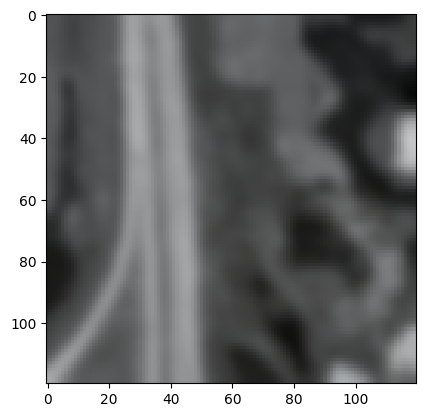

In [268]:
from scipy.ndimage import gaussian_filter
gauss_img =  gaussian_filter(dataset[0],2)
plt.imshow(gauss_img)


### 3.4.4 Shift Fourrier

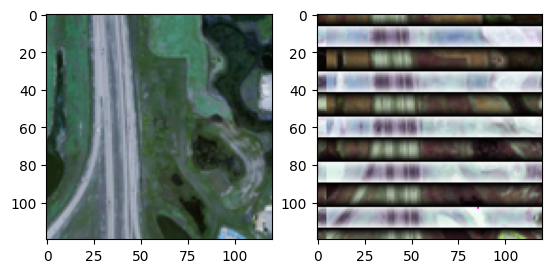

In [286]:
import numpy.fft
from scipy import ndimage
fig, (ax1, ax2) = plt.subplots(1, 2)
#plt.gray()  # show the filtered result in grayscale
input_ = numpy.fft.fft2(dataset[0])
result = ndimage.fourier_shift(input_, shift=5)
result = numpy.fft.ifft2(result)
ax1.imshow(dataset[0].astype('uint8'))
ax2.imshow(result.real.astype('uint8'))  # the imaginary part is an artifact
plt.show()

### 3.4.5 Shift

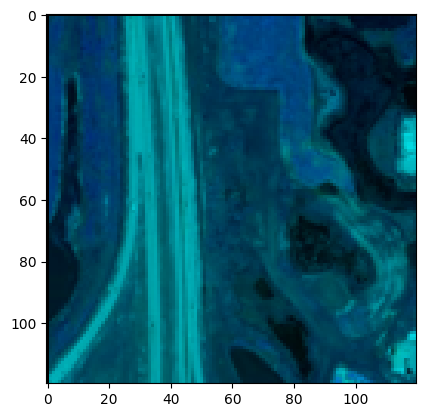

In [291]:
from scipy.ndimage import shift
shift_img =  shift(dataset[0],1)
plt.imshow(shift_img)


# ✂️ 4. Train & Test Split

In [15]:
#Split des data sous forme de np.array
x_train, x_test, y_train, y_test = train_test_split(dataset, lab,stratify=lab,  test_size=0.2, shuffle=True, random_state=42)

In [16]:
#Split des data sous forme de DateFrame
train_df, test_df = train_test_split(data, stratify=data["Labels"], test_size=0.2, shuffle=True, random_state=42)

# 📚 5. Modèles

## ✔️ 5.1 Simple CNN (configuré à la main)

### 5.1.1 Création et entrainement du modèle

In [17]:
model = tf.keras.Sequential([
    
    tf.keras.layers.Conv2D(filters=32,kernel_size=(3,3),strides=(2,2), activation="relu", padding="valid",input_shape=(pic_size,pic_size,3)),
    tf.keras.layers.MaxPooling2D((2, 2)),
    tf.keras.layers.Conv2D(filters=32,kernel_size=(3,3),strides=(2,2), activation="relu", padding="valid"),
    tf.keras.layers.MaxPooling2D((2, 2)),
    
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(units=64, activation='relu', 
                          kernel_regularizer=regularizers.L1L2(l1=1e-3, l2=1e-3), 
                          bias_regularizer=regularizers.L2(1e-2),
                          activity_regularizer=regularizers.L2(1e-3)),
    tf.keras.layers.Dropout(0.5),
    tf.keras.layers.Dense(units=1, activation='sigmoid'),
])

In [18]:
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 59, 59, 32)        896       
                                                                 
 max_pooling2d (MaxPooling2  (None, 29, 29, 32)        0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 14, 14, 32)        9248      
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 7, 7, 32)          0         
 g2D)                                                            
                                                                 
 flatten (Flatten)           (None, 1568)              0         
                                                                 
 dense (Dense)               (None, 64)                1

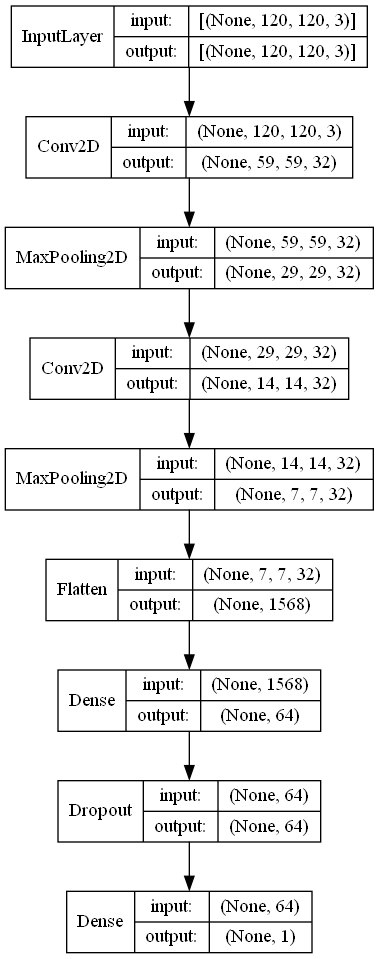

In [19]:
plot_model(model, show_shapes=True, show_layer_names=False)

In [20]:
visualkeras.layered_view(model, legend=False).show()

In [21]:
class_weights = class_weight.compute_class_weight(class_weight = "balanced", classes= np.unique(y_train), y= y_train)
class_weights = dict(zip(np.unique(y_train), class_weights))
class_weights

{0: 1.063803376365442, 1: 0.9434169969176575}

In [22]:
start = time.time()
history = model.fit(x_train,y_train,epochs = 100, class_weight=class_weights, validation_data=(x_test, y_test),verbose=1)
end = time.time()
print("Temps d'entrainement =",(format((end-start)/60)),"min")

Epoch 1/100
1072/1072 [==============================] - 41s 37ms/step - loss: 1.4853 - accuracy: 0.8513 - val_loss: 0.8192 - val_accuracy: 0.9225
Epoch 2/100
1072/1072 [==============================] - 51s 47ms/step - loss: 0.6350 - accuracy: 0.9178 - val_loss: 0.4382 - val_accuracy: 0.9338
Epoch 3/100
1072/1072 [==============================] - 40s 37ms/step - loss: 0.4002 - accuracy: 0.9228 - val_loss: 0.3269 - val_accuracy: 0.9319
Epoch 4/100
1072/1072 [==============================] - 40s 37ms/step - loss: 0.3210 - accuracy: 0.9285 - val_loss: 0.2944 - val_accuracy: 0.9342
Epoch 5/100
1072/1072 [==============================] - 40s 37ms/step - loss: 0.2947 - accuracy: 0.9298 - val_loss: 0.2968 - val_accuracy: 0.9382
Epoch 6/100
1072/1072 [==============================] - 43s 40ms/step - loss: 0.2837 - accuracy: 0.9328 - val_loss: 0.2255 - val_accuracy: 0.9461
Epoch 7/100
1072/1072 [==============================] - 42s 39ms/step - loss: 0.2836 - accuracy: 0.9331 - val_loss: 0

In [23]:
# Enregsitrement et chargement du modèle sous format .h5
 
# Enregistrement du modèle
model.save('./modeles/fire_detection_120_120/SimpleCNN_fire_120_120.h5')
print('Model Saved!')
 
# Chargement du modèle
savedModel=load_model('./modeles/fire_detection_120_120/SimpleCNN_fire_120_120.h5')
savedModel.summary()

Model Saved!
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 59, 59, 32)        896       
                                                                 
 max_pooling2d (MaxPooling2  (None, 29, 29, 32)        0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 14, 14, 32)        9248      
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 7, 7, 32)          0         
 g2D)                                                            
                                                                 
 flatten (Flatten)           (None, 1568)              0         
                                                                 
 dense (Dense)               (None, 64)    

### 5.1.2 Evaluation

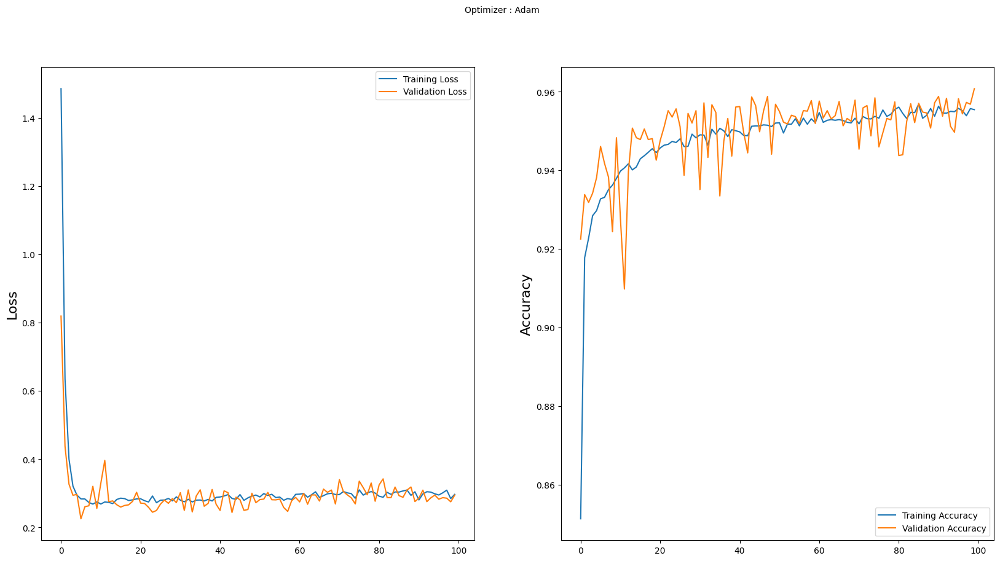

In [24]:
plt.figure(figsize=(20,10))
plt.subplot(1, 2, 1)
plt.suptitle('Optimizer : Adam', fontsize=10)
plt.ylabel('Loss', fontsize=16)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.legend(loc='upper right')

plt.subplot(1, 2, 2)
plt.ylabel('Accuracy', fontsize=16)
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.legend(loc='lower right')
plt.show()

In [25]:
results = model.evaluate(x_test, y_test)
print('The current model achieved an accuracy of {}%!'.format(round(results[1]*100,2)))

268/268 [==============================] - 3s 9ms/step - loss: 0.2948 - accuracy: 0.9608
The current model achieved an accuracy of 96.08%!


In [26]:
# compute predictions
predictions = model.predict(x_test)
y_pred = []
for i in predictions:
    if i >= 0.5:
        y_pred.append(1)
    else:
        y_pred.append(0)

268/268 [==============================] - 5s 9ms/step


In [27]:
def plot_confusion_matrix(cm, classes, title='Confusion matrix', cmap=plt.cm.Blues):
    cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
    plt.figure(figsize=(10,10))
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.tight_layout()

<Figure size 640x480 with 0 Axes>

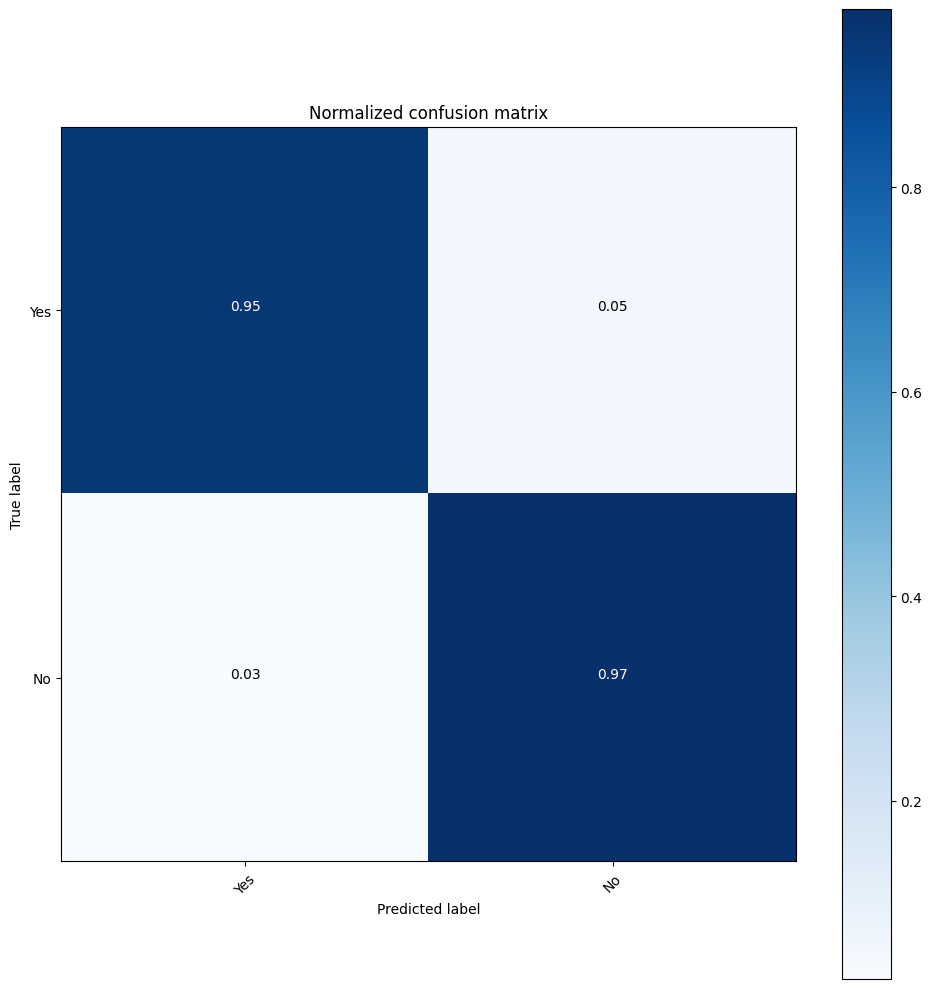

In [28]:
# compute confusion matrix
cnf_matrix = confusion_matrix(y_test, y_pred)
np.set_printoptions(precision=2)
# plot normalized confusion matrix
plt.figure()
plot_confusion_matrix(cnf_matrix, classes=["Yes", "No"], title='Normalized confusion matrix')
plt.show()

## ✔️ 5.2 Vision Transformers (ViT)

### 5.2.1 Paramètres

In [29]:
learning_rate = 0.001
weight_decay = 0.0001
batch_size = 256
num_epochs = 100
image_size = 120#240  # We'll resize input images to this size
patch_size = 20  # Size of the patches to be extract from the input images
num_patches = (image_size // patch_size) ** 2
projection_dim = 64
num_heads = 4
transformer_units = [
    projection_dim * 2,
    projection_dim,
]  # Size of the transformer layers
transformer_layers = 8
mlp_head_units = [2048, 1024]  # Size of the dense layers of the final classifier

### 5.2.2 Utilisation de l'augmentation

In [30]:
data_augmentation = tf.keras.Sequential(
    [
        layers.Normalization(),
        layers.Resizing(image_size, image_size),
        layers.RandomFlip("horizontal"),
        layers.RandomRotation(factor=0.02),
        layers.RandomZoom(
            height_factor=0.2, width_factor=0.2
        ),
    ],
    name="data_augmentation",
)
# Compute the mean and the variance of the training data for normalization.
data_augmentation.layers[0].adapt(x_train)

### 5.2.3 Multi-layer perceptron

In [31]:
def mlp(x, hidden_units, dropout_rate):
    for units in hidden_units:
        x = layers.Dense(units, activation=tf.nn.gelu)(x)
        x = layers.Dropout(dropout_rate)(x)
    return x

### 5.2.4 Implémentation de la couche "Patch"

In [18]:
class Patches(layers.Layer):
    def __init__(self, patch_size):
        super(Patches, self).__init__()
        self.patch_size = patch_size

    def call(self, images):
        batch_size = tf.shape(images)[0]
        patches = tf.image.extract_patches(
            images=images,
            sizes=[1, self.patch_size, self.patch_size, 1],
            strides=[1, self.patch_size, self.patch_size, 1],
            rates=[1, 1, 1, 1],
            padding="VALID",
        )
        patch_dims = patches.shape[-1]
        patches = tf.reshape(patches, [batch_size, -1, patch_dims])
        return patches

Image size: 120 X 120
Patch size: 20 X 20
Patches per image: 36
Elements per patch: 1200


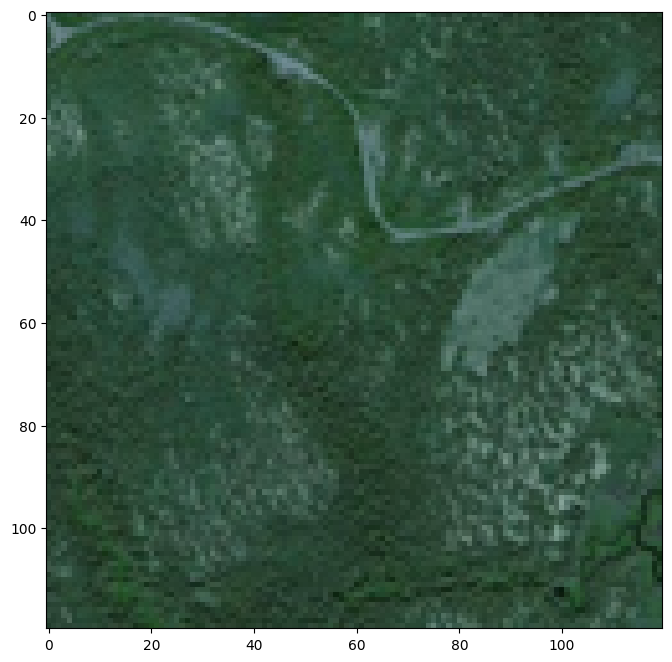

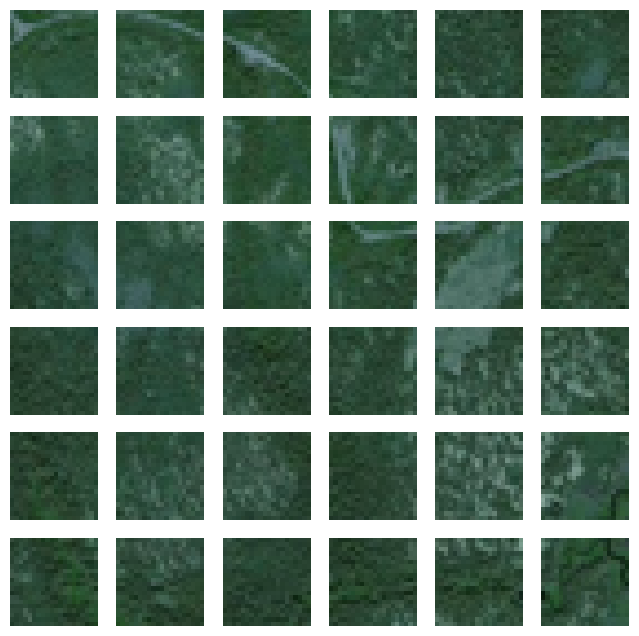

In [33]:
plt.figure(figsize=(8, 8))
image = x_train[np.random.choice(range(x_train.shape[0]))]
plt.imshow(image.astype("uint8"))

resized_image = tf.image.resize(
    tf.convert_to_tensor([image]), size=(image_size, image_size)
)
patches = Patches(patch_size)(resized_image)
print(f"Image size: {image_size} X {image_size}")
print(f"Patch size: {patch_size} X {patch_size}")
print(f"Patches per image: {patches.shape[1]}")
print(f"Elements per patch: {patches.shape[-1]}")

n = int(np.sqrt(patches.shape[1]))
plt.figure(figsize=(8, 8))
for i, patch in enumerate(patches[0]):
    ax = plt.subplot(n, n, i + 1)
    patch_img = tf.reshape(patch, (patch_size, patch_size, 3))
    plt.imshow(patch_img.numpy().astype("uint8"))
    plt.axis("off")


### 5.2.5 Création de l'encodeur pour le patch

In [19]:
class PatchEncoder(tf.keras.layers.Layer):
    def __init__(self, num_patches, projection_dim):
        super(PatchEncoder, self).__init__()
        self.num_patches = num_patches
        self.projection = layers.Dense(units=projection_dim)
        self.position_embedding = layers.Embedding(
            input_dim=num_patches, output_dim=projection_dim
        )

    def call(self, patch):
        positions = tf.range(start=0, limit=self.num_patches, delta=1)
        encoded = self.projection(patch) + self.position_embedding(positions)
        return encoded

### 5.2.6 Création et entrainement du modèle

In [35]:
def create_vit_classifier():
    inputs = layers.Input(shape=(120, 120, 3))#240, 240
    # Augment data.
    augmented = data_augmentation(inputs)
    # Create patches.
    patches = Patches(patch_size)(augmented)
    # Encode patches.
    encoded_patches = PatchEncoder(num_patches, projection_dim)(patches)

    # Create multiple layers of the Transformer block.
    for _ in range(transformer_layers):
        # Layer normalization 1.
        x1 = layers.LayerNormalization(epsilon=1e-6)(encoded_patches)
        # Create a multi-head attention layer.
        attention_output = layers.MultiHeadAttention(
            num_heads=num_heads, key_dim=projection_dim, dropout=0.1
        )(x1, x1)
        # Skip connection 1.
        x2 = layers.Add()([attention_output, encoded_patches])
        # Layer normalization 2.
        x3 = layers.LayerNormalization(epsilon=1e-6)(x2)
        # MLP.
        x3 = mlp(x3, hidden_units=transformer_units, dropout_rate=0.1)
        # Skip connection 2.
        encoded_patches = layers.Add()([x3, x2])

    # Create a [batch_size, projection_dim] tensor.
    representation = layers.LayerNormalization(epsilon=1e-6)(encoded_patches)
    representation = layers.Flatten()(representation)
    representation = layers.Dropout(0.5)(representation)
    # Add MLP.
    features = mlp(representation, hidden_units=mlp_head_units, dropout_rate=0.5)
    # Classify outputs.
    logits = layers.Dense(2)(features)
    # Create the Keras model.
    model = tf.keras.Model(inputs=inputs, outputs=logits)
    return model


In [36]:
def run_experiment(model):
    optimizer = tfa.optimizers.AdamW(
        learning_rate=learning_rate, weight_decay=weight_decay
    )

    model.compile(
        optimizer=optimizer,
        loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
        metrics=[
            tf.keras.metrics.SparseCategoricalAccuracy(name="accuracy"),
            tf.keras.metrics.SparseTopKCategoricalAccuracy(5, name="top-5-accuracy"),
        ],
    )

    checkpoint_filepath = "./tmp/checkpoint"
    checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
        checkpoint_filepath,
        monitor="val_accuracy",
        save_best_only=True,
        save_weights_only=True,
    )

    start = time.time()
    history = model.fit(
        x=x_train,
        y=y_train,
        batch_size=batch_size,
        epochs=num_epochs,
        validation_data=(x_test, y_test),
        callbacks=[checkpoint_callback],
    )
    end = time.time()
    print("Temps d'entrainement =",(format(((end-start)/60)/60),"heures"))

    model.load_weights(checkpoint_filepath)
    _, accuracy, top_5_accuracy = model.evaluate(x_test, y_test)
    print(f"Test accuracy: {round(accuracy * 100, 2)}%")
    print(f"Test top 5 accuracy: {round(top_5_accuracy * 100, 2)}%")
    
    model.save('./modeles/fire_detection_120_120/ViT_fire_120_120.h5')
    print('Model ViT enregistré!')

    return history, model

In [37]:
vit_classifier = create_vit_classifier()
vit_history, model_ViT = run_experiment(vit_classifier)

Epoch 1/100
134/134 [==============================] - 239s 2s/step - loss: 0.4435 - accuracy: 0.8703 - top-5-accuracy: 1.0000 - val_loss: 0.2241 - val_accuracy: 0.9102 - val_top-5-accuracy: 1.0000
Epoch 2/100
134/134 [==============================] - 229s 2s/step - loss: 0.2034 - accuracy: 0.9211 - top-5-accuracy: 1.0000 - val_loss: 0.1657 - val_accuracy: 0.9293 - val_top-5-accuracy: 1.0000
Epoch 3/100
134/134 [==============================] - 231s 2s/step - loss: 0.1708 - accuracy: 0.9345 - top-5-accuracy: 1.0000 - val_loss: 0.1477 - val_accuracy: 0.9415 - val_top-5-accuracy: 1.0000
Epoch 4/100
134/134 [==============================] - 231s 2s/step - loss: 0.1554 - accuracy: 0.9428 - top-5-accuracy: 1.0000 - val_loss: 0.1306 - val_accuracy: 0.9524 - val_top-5-accuracy: 1.0000
Epoch 5/100
134/134 [==============================] - 231s 2s/step - loss: 0.1436 - accuracy: 0.9463 - top-5-accuracy: 1.0000 - val_loss: 0.1211 - val_accuracy: 0.9537 - val_top-5-accuracy: 1.0000
Epoch 6/10

In [38]:
# Test load model
savedModel=load_model('./modeles/fire_detection_120_120/ViT_fire_120_120.h5', custom_objects={'Patches': Patches,'PatchEncoder': PatchEncoder})
savedModel.summary()
# Problème de nom couche à résoudre

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 120, 120, 3)]        0         []                            
                                                                                                  
 data_augmentation (Sequent  (None, 120, 120, 3)          7         ['input_1[0][0]']             
 ial)                                                                                             
                                                                                                  
 patches_2 (Patches)         (None, None, 1200)           0         ['data_augmentation[0][0]']   
                                                                                                  
 patch_encoder_1 (PatchEnco  (None, 36, 64)               79168     ['patches_2[0][0]']       

### 5.2.7 Evaluation

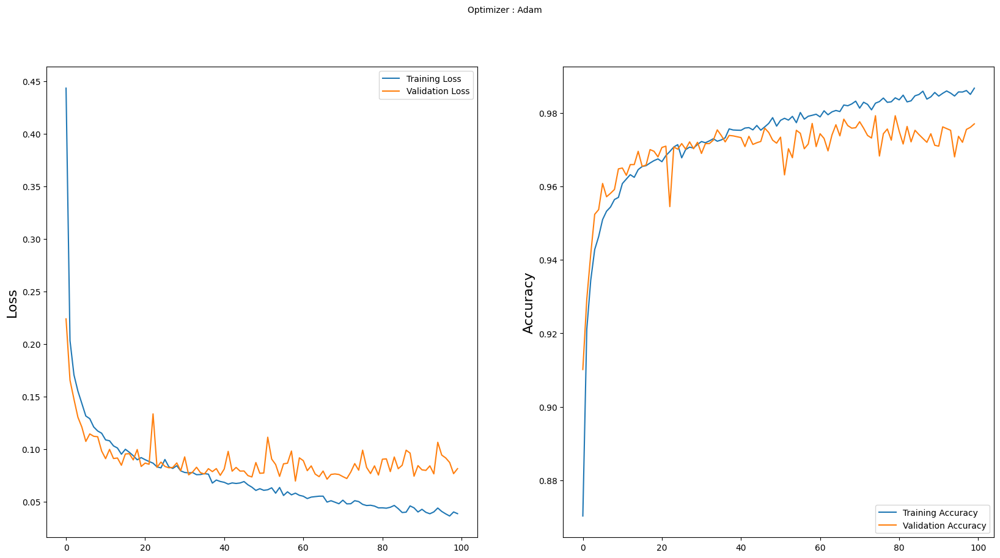

In [39]:
plt.figure(figsize=(20,10))
plt.subplot(1, 2, 1)
plt.suptitle('Optimizer : Adam', fontsize=10)
plt.ylabel('Loss', fontsize=16)
plt.plot(vit_history.history['loss'], label='Training Loss')
plt.plot(vit_history.history['val_loss'], label='Validation Loss')
plt.legend(loc='upper right')

plt.subplot(1, 2, 2)
plt.ylabel('Accuracy', fontsize=16)
plt.plot(vit_history.history['accuracy'], label='Training Accuracy')
plt.plot(vit_history.history['val_accuracy'], label='Validation Accuracy')
plt.legend(loc='lower right')
plt.show()

In [40]:
# compute predictions
vit_predictions = vit_classifier.predict(x_test)
vit_y_pred = [np.argmax(probas) for probas in vit_predictions]

268/268 [==============================] - 21s 75ms/step


<Figure size 640x480 with 0 Axes>

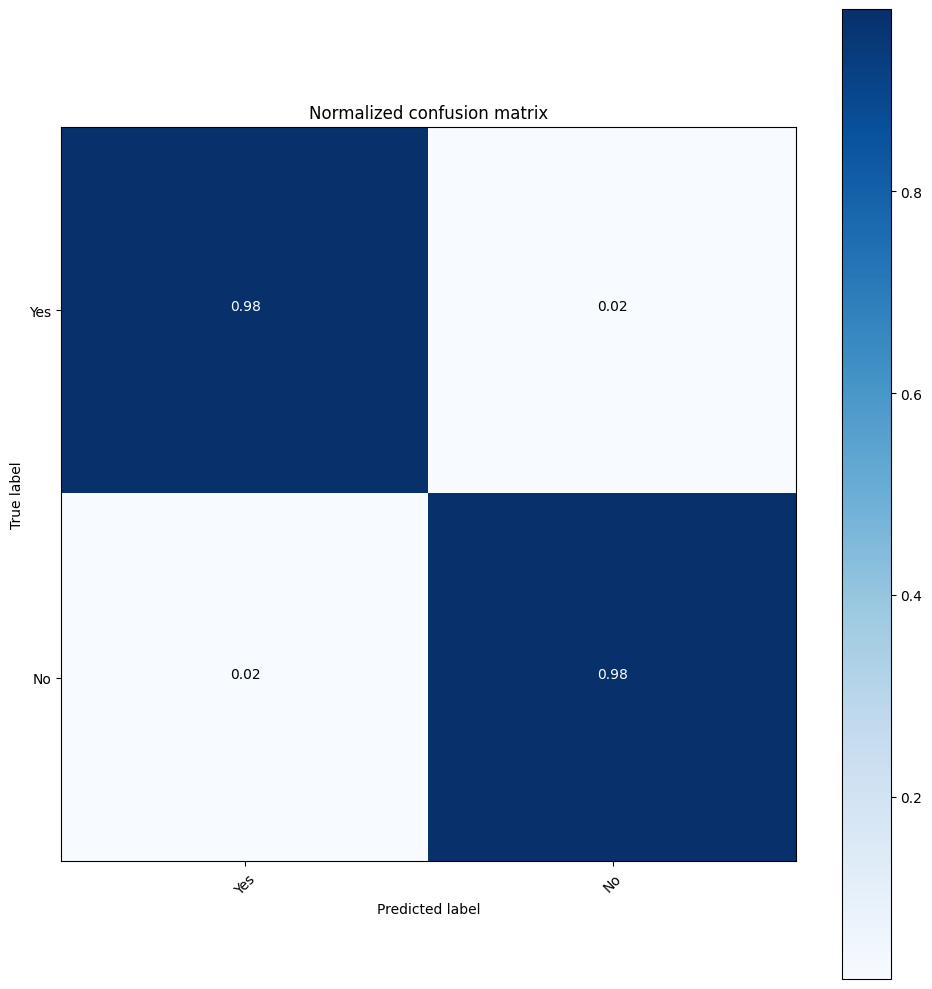

In [41]:
# compute confusion matrix
cnf_matrix = confusion_matrix(y_test, vit_y_pred)
np.set_printoptions(precision=2)
# plot normalized confusion matrix
plt.figure()
plot_confusion_matrix(cnf_matrix, classes=["Yes", "No"], title='Normalized confusion matrix')
plt.show()

## 5.3  Utilisation de CNNs de références

### 🚀Fonctions

In [17]:
def gen(pre,train,test):
    train_datagen = ImageDataGenerator(preprocessing_function=pre, validation_split=0.2)
    test_datagen = ImageDataGenerator(preprocessing_function=pre)
    
    train_gen = train_datagen.flow_from_dataframe(
        dataframe=train,
        x_col='File_Path',
        y_col='Labels',
        target_size=(120,120),
        class_mode='categorical',
        batch_size=32,
        shuffle=True,
        seed=0,
        subset='training',
        rotation_range=30,
        zoom_range=0.15,
        width_shift_range=0.2,
        height_shift_range=0.2,
        shear_range=0.15,
        horizontal_flip=True,
        fill_mode="nearest")
    valid_gen = train_datagen.flow_from_dataframe(
        dataframe=train,
        x_col='File_Path',
        y_col='Labels',
        target_size=(120,120),
        class_mode='categorical',
        batch_size=32,
        shuffle=False,
        seed=0,
        subset='validation',
        rotation_range=30,
        zoom_range=0.15,
        width_shift_range=0.2,
        height_shift_range=0.2,
        shear_range=0.15,
        horizontal_flip=True,
        fill_mode="nearest")
    test_gen = test_datagen.flow_from_dataframe(
        dataframe=test,
        x_col='File_Path',
        y_col='Labels',
        target_size=(120,120),
        color_mode='rgb',
        class_mode='categorical',
        batch_size=32,
        verbose=0,
        shuffle=False)
    return train_gen, valid_gen, test_gen

In [18]:
def func(name_model):
    pre_model = name_model(input_shape=(120,120, 3),
                   include_top=False,
                   weights='imagenet',
                   pooling='avg')
    pre_model.trainable = False
    inputs = pre_model.input
    x = Dense(120, activation='relu')(pre_model.output)
    x = Dense(120, activation='relu')(x)
    outputs = Dense(2, activation='softmax')(x)
    model = Model(inputs=inputs, outputs=outputs)
    model.compile(loss = 'categorical_crossentropy',optimizer='Adam',metrics=['accuracy'])
    my_callbacks  = [EarlyStopping(monitor='val_loss',
                              min_delta=0,
                              patience=2,
                              mode='auto')]
    return model, my_callbacks

In [19]:
def plot(history,test_gen,train_gen,model):
    # Plotting Accuracy, val_accuracy, loss, val_loss
    fig, ax = plt.subplots(1, 2, figsize=(10, 3))
    ax = ax.ravel()

    for i, met in enumerate(['accuracy', 'loss']):
        ax[i].plot(history.history[met])
        ax[i].plot(history.history['val_' + met])
        ax[i].set_title('Model {}'.format(met))
        ax[i].set_xlabel('epochs')
        ax[i].set_ylabel(met)
        ax[i].legend(['Train', 'Validation'])
        
    # Predict Data Test
    pred = model.predict(test_gen )
    pred = np.argmax(pred,axis=1)
    labels = (train_gen.class_indices)
    labels = dict((v,k) for k,v in labels.items())
    pred = [labels[k] for k in pred]
    
    # Classification report
    cm=confusion_matrix(test_df.Labels,pred)
    clr = classification_report(test_df.Labels, pred)
    print(clr)
    # Display 6 picture of the dataset with their labels
    fig, axes = plt.subplots(nrows=4, ncols=3, figsize=(12, 8),
                        subplot_kw={'xticks': [], 'yticks': []})

    for i, ax in enumerate(axes.flat):
        ax.imshow(plt.imread(test_df.File_Path.iloc[i+1]))
        ax.set_title(f"True: {test_df.Labels.iloc[i+1]}\nPredicted: {pred[i+1]}")
    plt.tight_layout()
    plt.show()
        
    return history

In [20]:
def result_test(test,model_use):
    results = model_use.evaluate(test, verbose=0)
    
    print("    Test Loss: {:.5f}".format(results[0]))
    print("Test Accuracy: {:.2f}%".format(results[1] * 100))
    
    return results

In [46]:
#STOP

### ✔️ 5.3.1 EfficientNetB7

Found 27424 validated image filenames belonging to 2 classes.
Found 6856 validated image filenames belonging to 2 classes.
Found 8570 validated image filenames belonging to 2 classes.
Temps d'entrainement = ('3.56947262816959', 'heures')
268/268 [==============================] - 455s 2s/step
              precision    recall  f1-score   support

          no       0.95      0.95      0.95      4028
         yes       0.96      0.95      0.96      4542

    accuracy                           0.95      8570
   macro avg       0.95      0.95      0.95      8570
weighted avg       0.95      0.95      0.95      8570



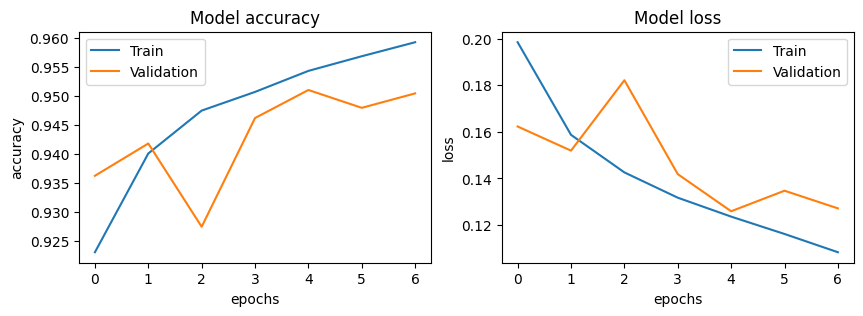

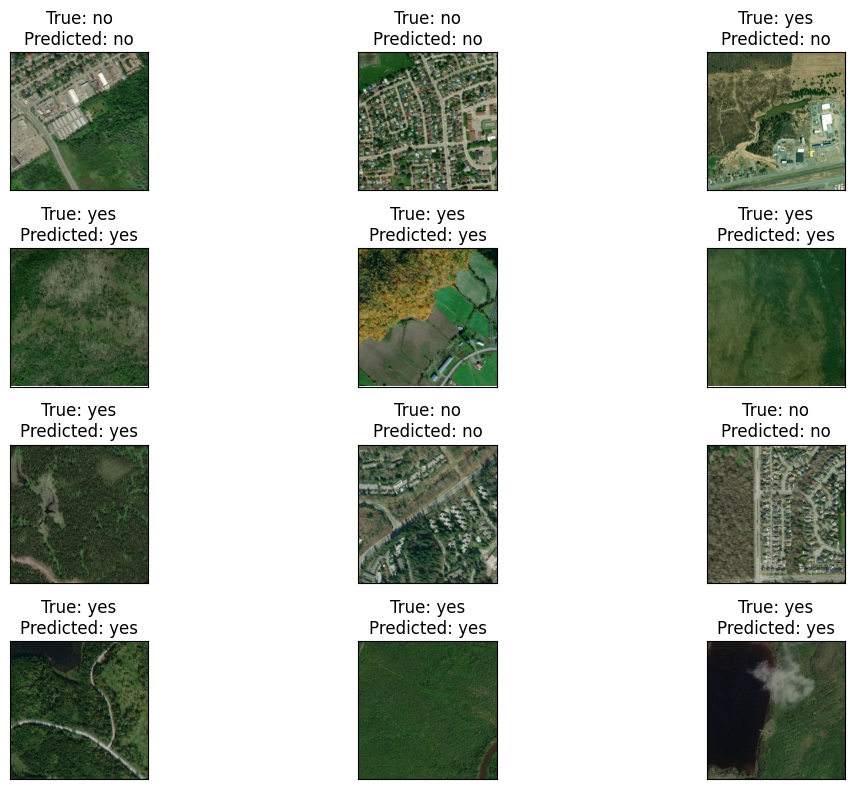

    Test Loss: 0.11920
Test Accuracy: 95.36%


In [47]:
from tensorflow.keras.applications import EfficientNetB7
from tensorflow.keras.applications.efficientnet import preprocess_input
ENet_pre=preprocess_input
train_gen_ENet, valid_gen_ENet, test_gen_ENet = gen(ENet_pre,train_df,test_df)
ENet_model, callback=func(EfficientNetB7)
start = time.time()
history = ENet_model.fit(
    train_gen_ENet,
    validation_data=valid_gen_ENet,
    epochs=100,
    callbacks=callback,
    verbose=0
)
end = time.time()
print("Temps d'entrainement =",(format(((end-start)/60)/60),"heures"))
history_ENet=plot(history,test_gen_ENet,train_gen_ENet, ENet_model)

result_ENet = result_test(test_gen_ENet,ENet_model)

In [48]:
# Enregsitrement et chargement du modèle sous format .h5
 
# Enregistrement du modèle
ENet_model.save('./modeles/CNN_ref/EfficientNetB7_fire_120_120.h5')
print('ENet_model enregistré!')
 
# Chargement du modèle
savedModel=load_model('./modeles/CNN_ref/EfficientNetB7_fire_120_120.h5')
savedModel.summary()

ENet_model enregistré!
Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_2 (InputLayer)        [(None, 120, 120, 3)]        0         []                            
                                                                                                  
 rescaling (Rescaling)       (None, 120, 120, 3)          0         ['input_2[0][0]']             
                                                                                                  
 normalization_1 (Normaliza  (None, 120, 120, 3)          7         ['rescaling[0][0]']           
 tion)                                                                                            
                                                                                                  
 rescaling_1 (Rescaling)     (None, 120, 120, 3)          0         [

### ✔️ 5.3.2 ResNet

Found 27424 validated image filenames belonging to 2 classes.
Found 6856 validated image filenames belonging to 2 classes.
Found 8570 validated image filenames belonging to 2 classes.
Temps d'entrainement = ('0.587332686384519', 'heures')
268/268 [==============================] - 133s 492ms/step
              precision    recall  f1-score   support

          no       0.97      0.97      0.97      4028
         yes       0.97      0.97      0.97      4542

    accuracy                           0.97      8570
   macro avg       0.97      0.97      0.97      8570
weighted avg       0.97      0.97      0.97      8570



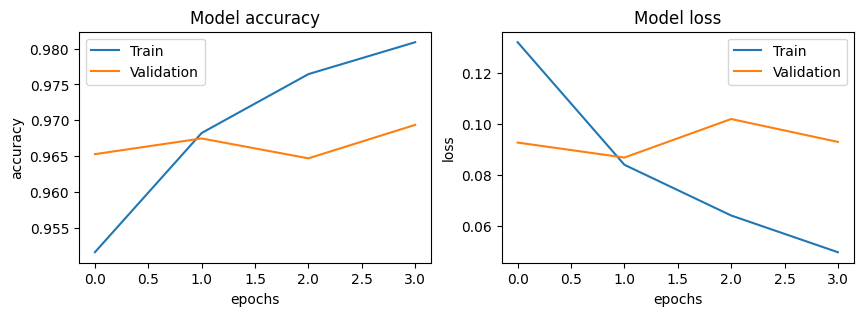

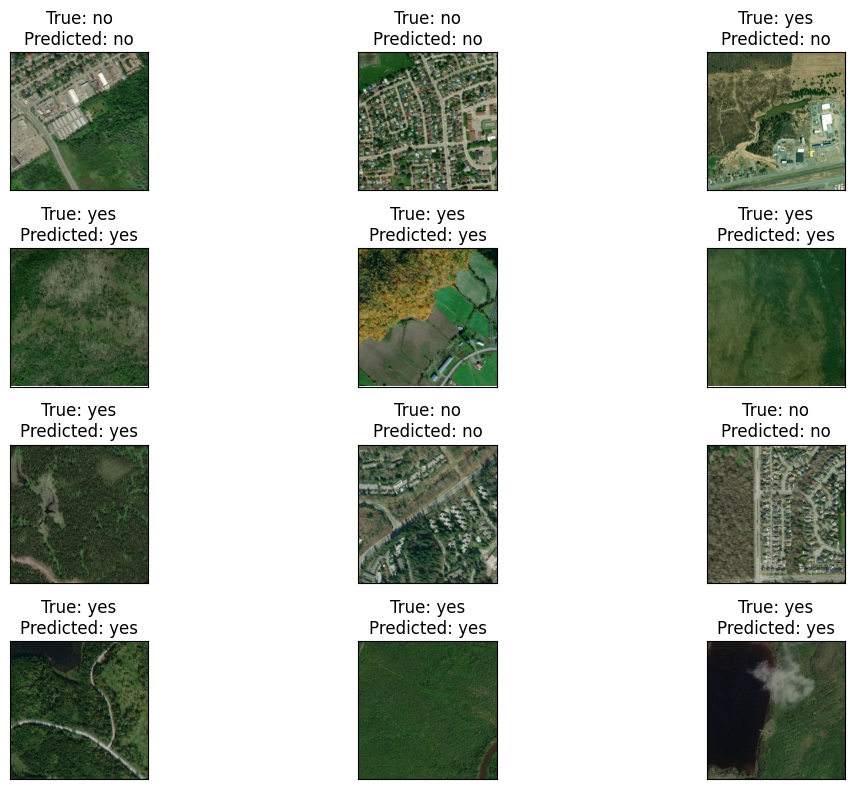

    Test Loss: 0.08821
Test Accuracy: 97.09%


In [49]:
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.applications.resnet50 import preprocess_input
ResNet_pre=preprocess_input
train_gen_ResNet, valid_gen_ResNet, test_gen_ResNet = gen(ResNet_pre,train_df,test_df)
ResNet_model, callback=func(ResNet50)
start = time.time()
history = ResNet_model.fit(
    train_gen_ResNet,
    validation_data=valid_gen_ResNet,
    epochs=100,
    callbacks=callback,
    verbose=0
)
end = time.time()
print("Temps d'entrainement =",(format(((end-start)/60)/60),"heures"))
history_ResNet= plot(history,test_gen_ResNet,train_gen_ResNet, ResNet_model)

result_ResNet = result_test(test_gen_ResNet,ResNet_model)

In [50]:
# Enregsitrement et chargement du modèle sous format .h5
 
# Enregistrement du modèle
ResNet_model.save('./modeles/CNN_ref/ResNet_model_fire_120_120.h5')
print('ResNet_model enregistré!')
 
# Chargement du modèle
savedModel=load_model('./modeles/CNN_ref/ResNet_model_fire_120_120.h5')
savedModel.summary()

ResNet_model enregistré!
Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_3 (InputLayer)        [(None, 120, 120, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 126, 126, 3)          0         ['input_3[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 60, 60, 64)           9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 60, 60, 64)           256       ['conv1_conv[0][0]']          
 on)                                                               

### ✔️ 5.3.3 MobileNet

Found 27424 validated image filenames belonging to 2 classes.
Found 6856 validated image filenames belonging to 2 classes.
Found 8570 validated image filenames belonging to 2 classes.
Temps d'entrainement = ('0.1504035292731391', 'heures')
268/268 [==============================] - 35s 127ms/step
              precision    recall  f1-score   support

          no       0.94      0.96      0.95      4028
         yes       0.96      0.95      0.96      4542

    accuracy                           0.95      8570
   macro avg       0.95      0.95      0.95      8570
weighted avg       0.95      0.95      0.95      8570



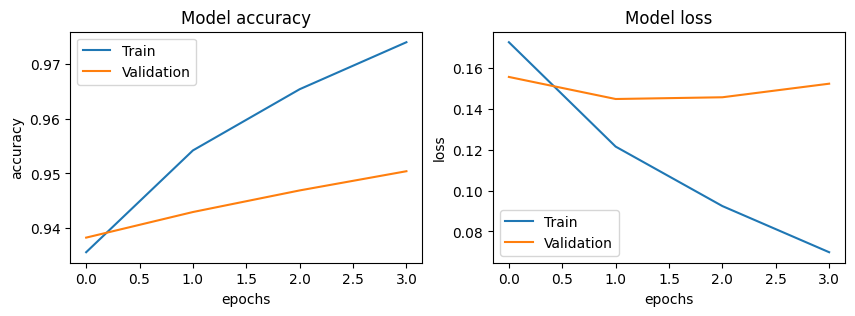

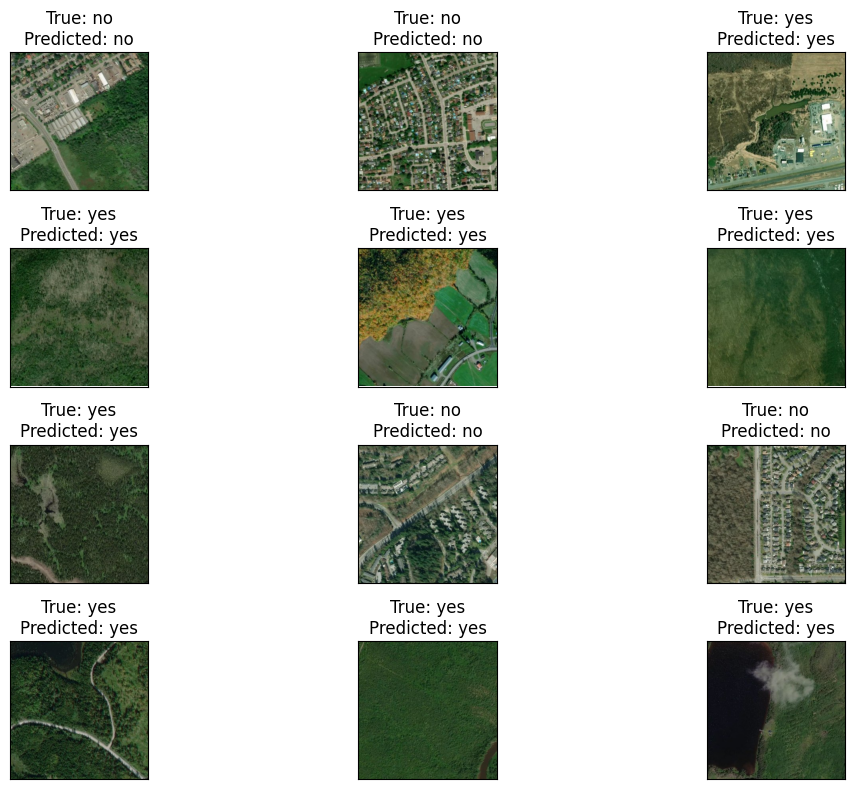

    Test Loss: 0.13651
Test Accuracy: 95.43%


In [51]:
from tensorflow.keras.applications import MobileNet
from tensorflow.keras.applications.mobilenet import preprocess_input
MobileNet_pre=preprocess_input
train_gen_MobileNet, valid_gen_MobileNet, test_gen_MobileNet = gen(MobileNet_pre,train_df,test_df)
MobileNet_model, callback=func(MobileNet)
start = time.time()
history = MobileNet_model.fit(
    train_gen_MobileNet,
    validation_data=valid_gen_MobileNet,
    epochs=100,
    callbacks=callback,
    verbose=0
)
end = time.time()
print("Temps d'entrainement =",(format(((end-start)/60)/60),"heures"))
history_MobileNet = plot(history,test_gen_MobileNet,train_gen_MobileNet, MobileNet_model)

result_MobileNet = result_test(test_gen_MobileNet,MobileNet_model)

In [52]:
# Enregsitrement et chargement du modèle sous format .h5
 
# Enregistrement du modèle
MobileNet_model.save('./modeles/CNN_ref/MobileNet_model_fire_120_120.h5')
print('MobileNet_model enregistré!')
 
# Chargement du modèle
savedModel=load_model('./modeles/CNN_ref/MobileNet_model_fire_120_120.h5')
savedModel.summary()

MobileNet_model enregistré!
Model: "model_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_4 (InputLayer)        [(None, 120, 120, 3)]     0         
                                                                 
 conv1 (Conv2D)              (None, 60, 60, 32)        864       
                                                                 
 conv1_bn (BatchNormalizati  (None, 60, 60, 32)        128       
 on)                                                             
                                                                 
 conv1_relu (ReLU)           (None, 60, 60, 32)        0         
                                                                 
 conv_dw_1 (DepthwiseConv2D  (None, 60, 60, 32)        288       
 )                                                               
                                                                 
 conv_dw_1_bn (BatchNormali  (N

### ✔️ 5.3.4 VGG19

Found 27424 validated image filenames belonging to 2 classes.
Found 6856 validated image filenames belonging to 2 classes.
Found 8570 validated image filenames belonging to 2 classes.
Temps d'entrainement = ('2.1677236553033192', 'heures')
268/268 [==============================] - 326s 1s/step
              precision    recall  f1-score   support

          no       0.95      0.95      0.95      4028
         yes       0.95      0.96      0.96      4542

    accuracy                           0.95      8570
   macro avg       0.95      0.95      0.95      8570
weighted avg       0.95      0.95      0.95      8570



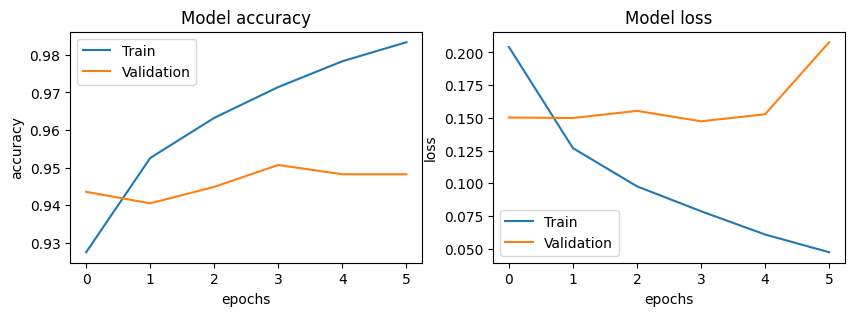

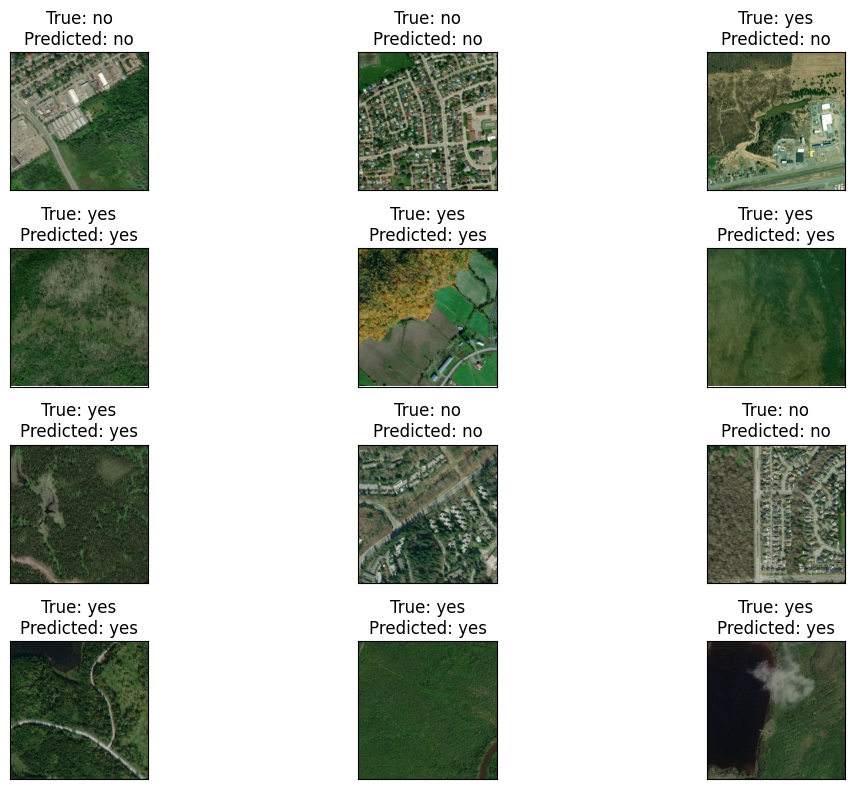

    Test Loss: 0.17854
Test Accuracy: 95.40%


In [53]:
from tensorflow.keras.applications import VGG19
from tensorflow.keras.applications.vgg19 import preprocess_input
VGG19_pre=preprocess_input
train_gen_VGG19, valid_gen_VGG19, test_gen_VGG19 = gen(VGG19_pre,train_df,test_df)
VGG19_model, callback=func(VGG19)
start = time.time()
history = VGG19_model.fit(
    train_gen_VGG19,
    validation_data=valid_gen_VGG19,
    epochs=100,
    callbacks=callback,
    verbose=0
)
end = time.time()
print("Temps d'entrainement =",(format(((end-start)/60)/60),"heures"))
history_VGG19= plot(history,test_gen_VGG19,train_gen_VGG19, VGG19_model)

result_VGG19 = result_test(test_gen_VGG19,VGG19_model)

In [54]:
# Enregsitrement et chargement du modèle sous format .h5
 
# Enregistrement du modèle
VGG19_model.save('./modeles/CNN_ref/VGG19_model_fire_120_120.h5')
print('VGG19_model enregistré!')
 
# Chargement du modèle
savedModel=load_model('./modeles/CNN_ref/VGG19_model_fire_120_120.h5')
savedModel.summary()

VGG19_model enregistré!
Model: "model_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_5 (InputLayer)        [(None, 120, 120, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 120, 120, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 120, 120, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 60, 60, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 60, 60, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 60, 60, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None,

### ✔️ 5.3.5 Xception

Found 27424 validated image filenames belonging to 2 classes.
Found 6856 validated image filenames belonging to 2 classes.
Found 8570 validated image filenames belonging to 2 classes.
Temps d'entrainement = ('0.751770532131195', 'heures')
268/268 [==============================] - 136s 506ms/step
              precision    recall  f1-score   support

          no       0.93      0.94      0.94      4028
         yes       0.95      0.94      0.94      4542

    accuracy                           0.94      8570
   macro avg       0.94      0.94      0.94      8570
weighted avg       0.94      0.94      0.94      8570



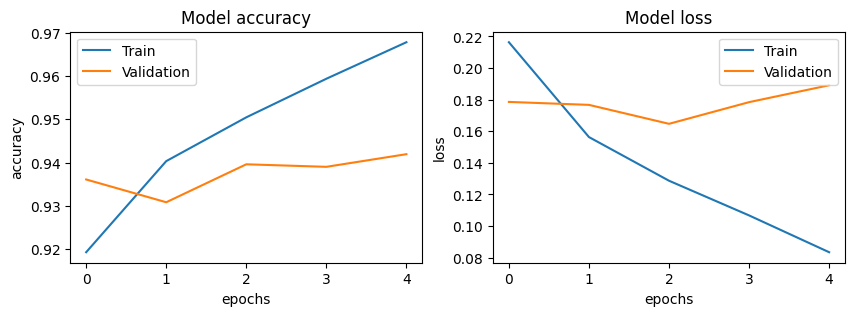

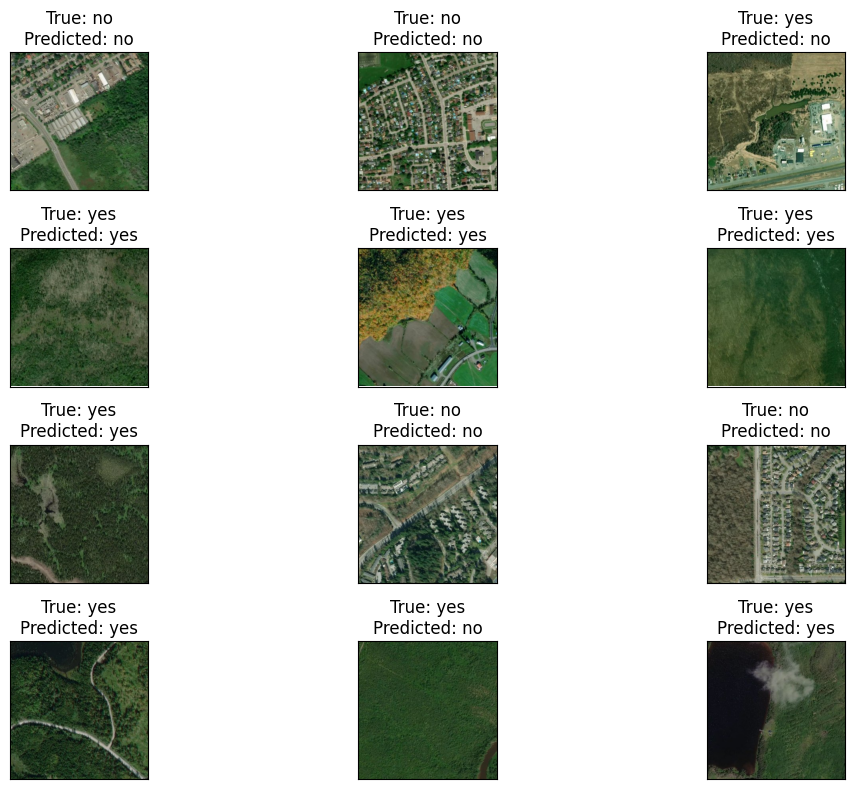

    Test Loss: 0.18511
Test Accuracy: 94.00%


In [55]:
from tensorflow.keras.applications import Xception
from tensorflow.keras.applications.xception import preprocess_input
Xception_pre=preprocess_input
train_gen_Xception, valid_gen_Xception, test_gen_Xception = gen(Xception_pre,train_df,test_df)
Xception_model, callback=func(Xception)
start = time.time()
history = Xception_model.fit(
    train_gen_Xception,
    validation_data=valid_gen_Xception,
    epochs=100,
    callbacks=callback,
    verbose=0
)
end = time.time()
print("Temps d'entrainement =",(format(((end-start)/60)/60),"heures"))
history_Xception = plot(history,test_gen_Xception,train_gen_Xception, Xception_model)
result_Xception = result_tresult_Xception = result_test(test_gen_Xception,Xception_model)

In [57]:
# Enregsitrement et chargement du modèle sous format .h5
 
# Enregistrement du modèle
Xception_model.save('./modeles/CNN_ref/Xception_model_fire_120_120.h5')
print('Xception_model enregistré!')
 
# Chargement du modèle
savedModel=load_model('./modeles/CNN_ref/Xception_model_fire_120_120.h5')
savedModel.summary()

Xception_model enregistré!
Model: "model_5"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_6 (InputLayer)        [(None, 120, 120, 3)]        0         []                            
                                                                                                  
 block1_conv1 (Conv2D)       (None, 59, 59, 32)           864       ['input_6[0][0]']             
                                                                                                  
 block1_conv1_bn (BatchNorm  (None, 59, 59, 32)           128       ['block1_conv1[0][0]']        
 alization)                                                                                       
                                                                                                  
 block1_conv1_act (Activati  (None, 59, 59, 32)           0      

### ✔️ 5.3.6 InceptionResNetV2

Found 27424 validated image filenames belonging to 2 classes.
Found 6856 validated image filenames belonging to 2 classes.
Found 8570 validated image filenames belonging to 2 classes.
Temps d'entrainement = ('0.7544115378459294', 'heures')
268/268 [==============================] - 149s 546ms/step
              precision    recall  f1-score   support

          no       0.92      0.94      0.93      4028
         yes       0.94      0.93      0.94      4542

    accuracy                           0.94      8570
   macro avg       0.93      0.94      0.94      8570
weighted avg       0.94      0.94      0.94      8570



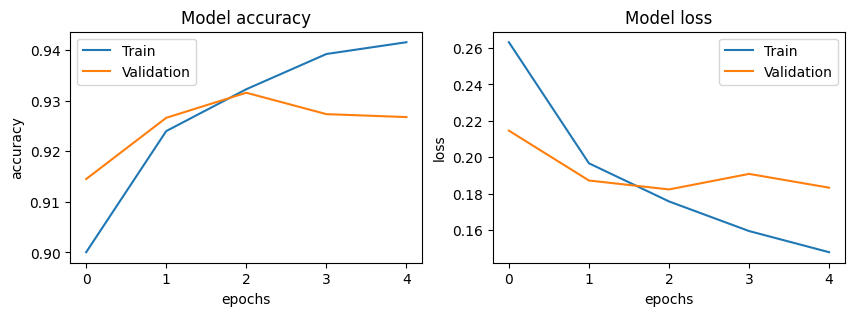

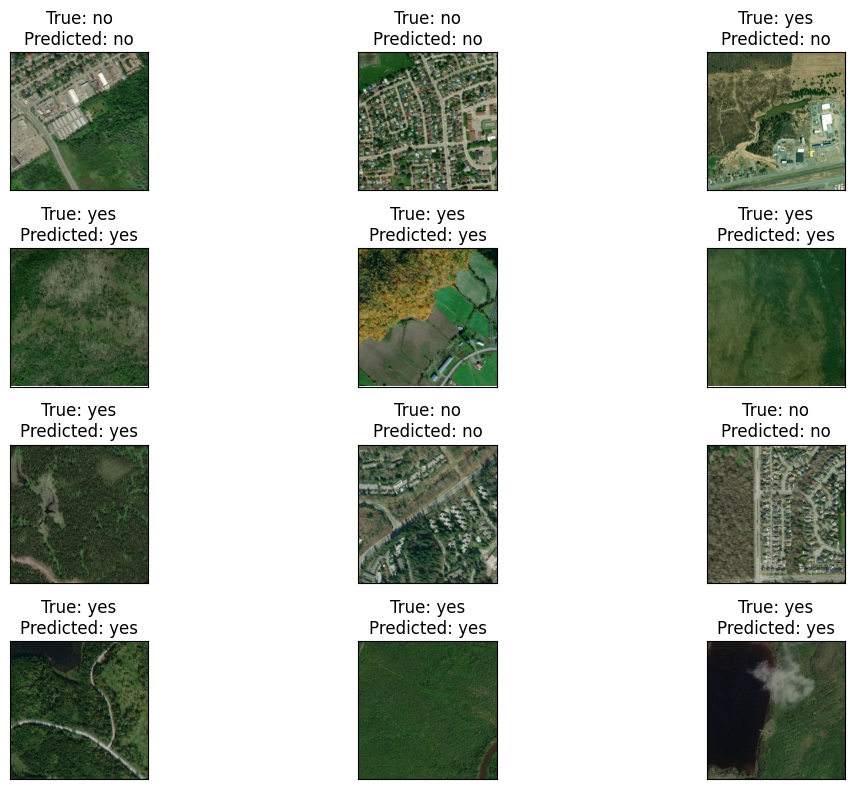

    Test Loss: 0.17302
Test Accuracy: 93.54%


In [58]:
from tensorflow.keras.applications import InceptionResNetV2
from tensorflow.keras.applications.inception_resnet_v2 import preprocess_input
IRNV2_pre=preprocess_input
train_gen_IRNV2, valid_gen_IRNV2, test_gen_IRNV2 = gen(IRNV2_pre,train_df,test_df)
IRNV2_model, callback=func(InceptionResNetV2)
start = time.time()
history = IRNV2_model.fit(
    train_gen_IRNV2,
    validation_data=valid_gen_IRNV2,
    epochs=100,
    callbacks=callback,
    verbose=0
)
end = time.time()
print("Temps d'entrainement =",(format(((end-start)/60)/60),"heures"))
history_IRNV2 =plot(history,test_gen_IRNV2,train_gen_IRNV2, IRNV2_model)
result_IRNV2 = result_tresult_IRNV2 = result_test(test_gen_IRNV2,IRNV2_model)

In [59]:
# Enregsitrement et chargement du modèle sous format .h5
 
# Enregistrement du modèle
IRNV2_model.save('./modeles/CNN_ref/IRNV2_model_fire_120_120.h5')
print('IRNV2_model enregistré!')
 
# Chargement du modèle
savedModel=load_model('./modeles/CNN_ref/IRNV2_model_fire_120_120.h5')
savedModel.summary()

IRNV2_model enregistré!
Model: "model_6"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_7 (InputLayer)        [(None, 120, 120, 3)]        0         []                            
                                                                                                  
 conv2d_6 (Conv2D)           (None, 59, 59, 32)           864       ['input_7[0][0]']             
                                                                                                  
 batch_normalization_4 (Bat  (None, 59, 59, 32)           96        ['conv2d_6[0][0]']            
 chNormalization)                                                                                 
                                                                                                  
 activation (Activation)     (None, 59, 59, 32)           0         

### ✔️ 5.3.7 VGG16

Found 27424 validated image filenames belonging to 2 classes.
Found 6856 validated image filenames belonging to 2 classes.
Found 8570 validated image filenames belonging to 2 classes.
Temps d'entrainement = ('1.668921857939826', 'heures')
268/268 [==============================] - 320s 1s/step
              precision    recall  f1-score   support

          no       0.95      0.95      0.95      4028
         yes       0.96      0.96      0.96      4542

    accuracy                           0.96      8570
   macro avg       0.96      0.96      0.96      8570
weighted avg       0.96      0.96      0.96      8570



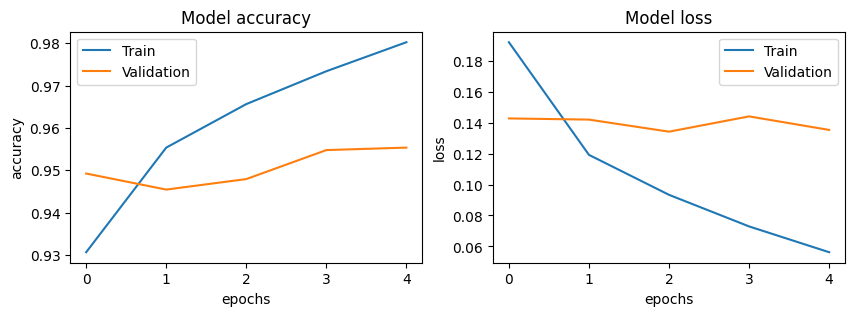

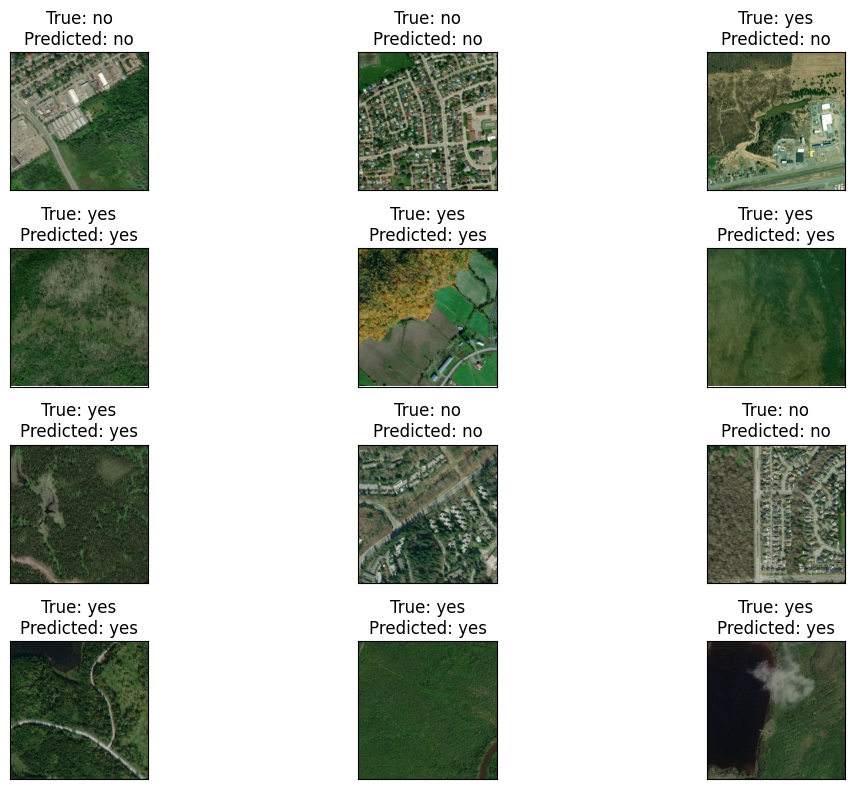

    Test Loss: 0.14714
Test Accuracy: 95.53%


In [60]:
from tensorflow.keras.applications import VGG16
from tensorflow.keras.applications.vgg16 import preprocess_input

vgg_pre=preprocess_input
train_gen_VGG, valid_gen_VGG, test_gen_VGG = gen(vgg_pre,train_df,test_df)
model_VGG16, callback=func(VGG16)
start = time.time()
history = model_VGG16.fit(
    train_gen_VGG,
    validation_data=valid_gen_VGG,
    epochs=100,
    callbacks=callback,
    verbose=0
)
end = time.time()
print("Temps d'entrainement =",(format(((end-start)/60)/60),"heures"))
history=plot(history,test_gen_VGG,train_gen_VGG, model_VGG16)
result_VGG16 = result_test(test_gen_VGG,model_VGG16)

In [61]:
# Enregsitrement et chargement du modèle sous format .h5
 
# Enregistrement du modèle
model_VGG16.save('./modeles/CNN_ref/model_VGG16_fire_120_120.h5')
print('model_VGG16 enregistré!')
 
# Chargement du modèle
savedModel=load_model('./modeles/CNN_ref/model_VGG16_fire_120_120.h5')
savedModel.summary()

model_VGG16 enregistré!
Model: "model_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_8 (InputLayer)        [(None, 120, 120, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 120, 120, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 120, 120, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 60, 60, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 60, 60, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 60, 60, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None,

### ✔️ 5.3.8 ResNet101

Found 27424 validated image filenames belonging to 2 classes.
Found 6856 validated image filenames belonging to 2 classes.
Found 8570 validated image filenames belonging to 2 classes.
Temps d'entrainement = ('1.1396649161312316', 'heures')
268/268 [==============================] - 243s 885ms/step
              precision    recall  f1-score   support

          no       0.96      0.98      0.97      4028
         yes       0.98      0.96      0.97      4542

    accuracy                           0.97      8570
   macro avg       0.97      0.97      0.97      8570
weighted avg       0.97      0.97      0.97      8570



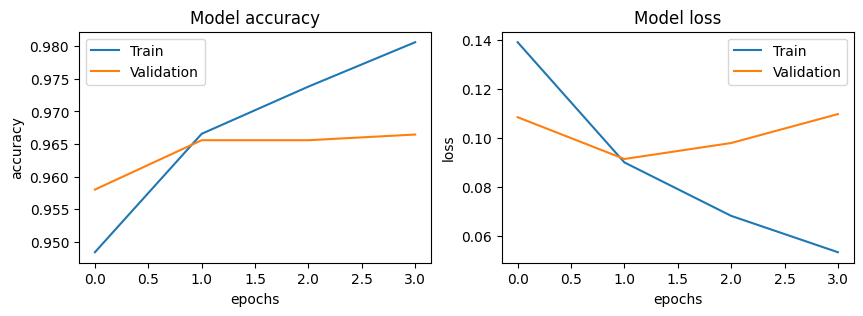

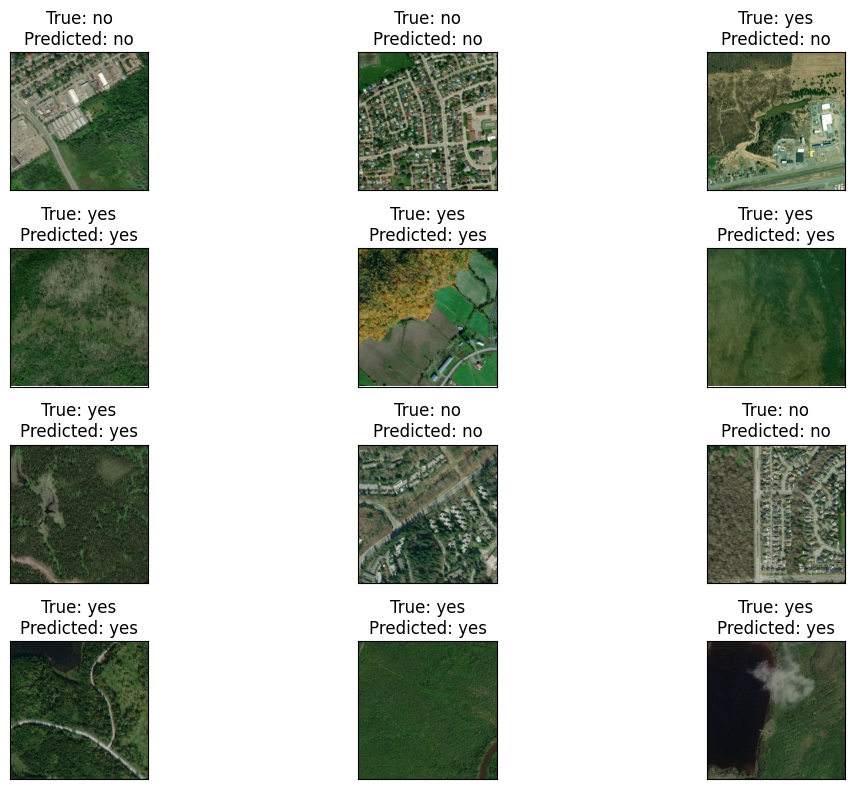

    Test Loss: 0.10876
Test Accuracy: 96.73%


In [62]:
from tensorflow.keras.applications import ResNet101
from tensorflow.keras.applications.resnet import preprocess_input

ResNet101_pre=preprocess_input
train_gen_ResNet101, valid_gen_ResNet101, test_gen_ResNet101 = gen(ResNet101_pre,train_df,test_df)
model_ResNet101, callback=func(ResNet101)
start = time.time()
history = model_ResNet101.fit(
    train_gen_ResNet101,
    validation_data=valid_gen_ResNet101,
    epochs=100,
    callbacks=callback,
    verbose=0
)
end = time.time()
print("Temps d'entrainement =",(format(((end-start)/60)/60),"heures"))
history=plot(history,test_gen_ResNet101,train_gen_ResNet101, model_ResNet101)
result_ResNet101 = result_test(test_gen_ResNet101,model_ResNet101)

In [63]:
# Enregsitrement et chargement du modèle sous format .h5
 
# Enregistrement du modèle
model_ResNet101.save('./modeles/CNN_ref/model_ResNet101_fire_120_120.h5')
print('model_ResNet101 enregistré!')
 
# Chargement du modèle
savedModel=load_model('./modeles/CNN_ref/model_ResNet101_fire_120_120.h5')
savedModel.summary()

model_ResNet101 enregistré!
Model: "model_8"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_9 (InputLayer)        [(None, 120, 120, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 126, 126, 3)          0         ['input_9[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 60, 60, 64)           9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 60, 60, 64)           256       ['conv1_conv[0][0]']          
 on)                                                            

### ✔️ 5.3.9 DenseNet201

Found 27424 validated image filenames belonging to 2 classes.
Found 6856 validated image filenames belonging to 2 classes.
Found 8570 validated image filenames belonging to 2 classes.
Temps d'entrainement = ('0.9299692325459586', 'heures')
268/268 [==============================] - 233s 826ms/step
              precision    recall  f1-score   support

          no       0.96      0.96      0.96      4028
         yes       0.96      0.96      0.96      4542

    accuracy                           0.96      8570
   macro avg       0.96      0.96      0.96      8570
weighted avg       0.96      0.96      0.96      8570



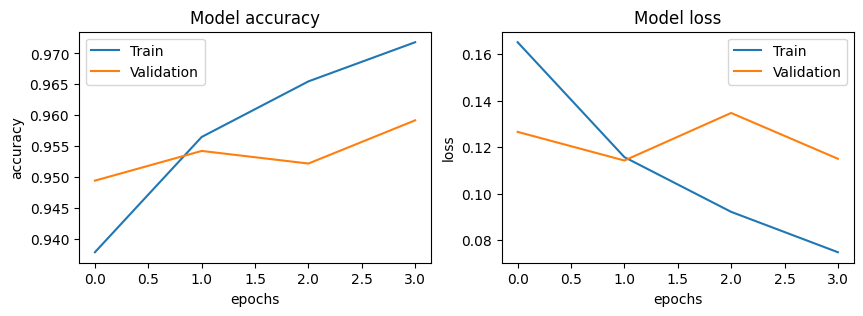

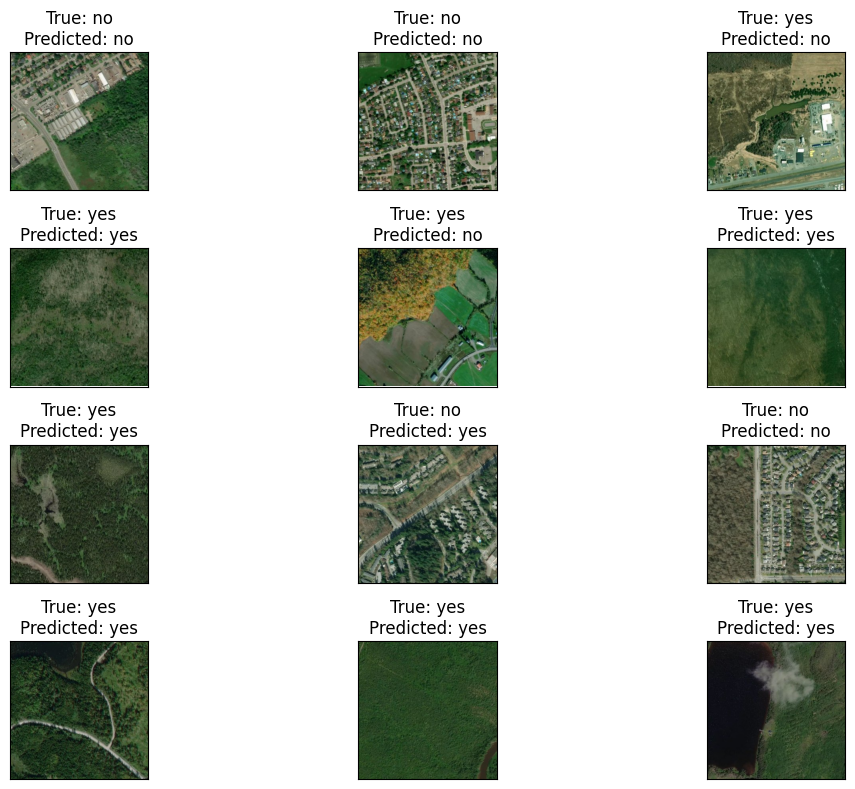

    Test Loss: 0.11926
Test Accuracy: 96.03%


In [64]:
from tensorflow.keras.applications import DenseNet201
from tensorflow.keras.applications.densenet import preprocess_input

DenseNet201_pre=preprocess_input
train_gen_DenseNet201, valid_gen_DenseNet201, test_gen_DenseNet201 = gen(DenseNet201_pre,train_df,test_df)
model_DenseNet201, callback=func(DenseNet201)
start = time.time()
history = model_DenseNet201.fit(
    train_gen_DenseNet201,
    validation_data=valid_gen_DenseNet201,
    epochs=100,
    callbacks=callback,
    verbose=0
)
end = time.time()
print("Temps d'entrainement =",(format(((end-start)/60)/60),"heures"))
history=plot(history,test_gen_DenseNet201,train_gen_DenseNet201, model_DenseNet201)
result_DenseNet201 = result_test(test_gen_DenseNet201,model_DenseNet201)

In [65]:
# Enregsitrement et chargement du modèle sous format .h5
 
# Enregistrement du modèle
model_DenseNet201.save('./modeles/CNN_ref/model_DenseNet201_fire_120_120.h5')
print('model_DenseNet201 enregistré!')
 
# Chargement du modèle
savedModel=load_model('./modeles/CNN_ref/model_DenseNet201_fire_120_120.h5')
savedModel.summary()

model_DenseNet201 enregistré!
Model: "model_9"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_10 (InputLayer)       [(None, 120, 120, 3)]        0         []                            
                                                                                                  
 zero_padding2d (ZeroPaddin  (None, 126, 126, 3)          0         ['input_10[0][0]']            
 g2D)                                                                                             
                                                                                                  
 conv1/conv (Conv2D)         (None, 60, 60, 64)           9408      ['zero_padding2d[0][0]']      
                                                                                                  
 conv1/bn (BatchNormalizati  (None, 60, 60, 64)           256 

### 📊 5.3.10  Bilan des performances des CNNs de références

In [66]:
output = pd.DataFrame({'Model':['EfficientNetB7','ResNet50','MobileNet','VGG19','Xception','InceptionResNetV2',
                               'VGG16','ResNet101','DenseNet201'],
                      'Accuracy':[result_ENet[1], result_ResNet[1], result_MobileNet[1], result_VGG19[1],
                                  result_Xception[1],result_IRNV2[1],result_VGG16[1],result_ResNet101[1],
                                 result_DenseNet201[1]]})

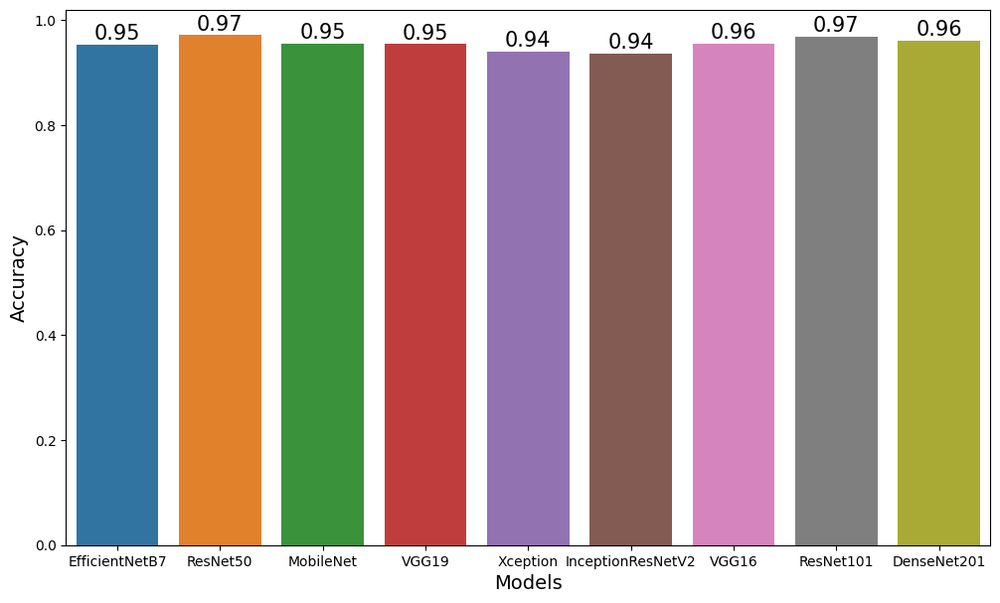

In [74]:
plt.figure(figsize=(12, 7))
plots = sns.barplot(x='Model', y='Accuracy', data=output)
for bar in plots.patches:
    plots.annotate(format(bar.get_height(), '.2f'),
                   (bar.get_x() + bar.get_width() / 2,
                    bar.get_height()), ha='center', va='center',
                   size=15, xytext=(0, 8),
                   textcoords='offset points')

plt.xlabel("Models", size=14)
plt.ylabel("Accuracy", size=14)
plt.show()

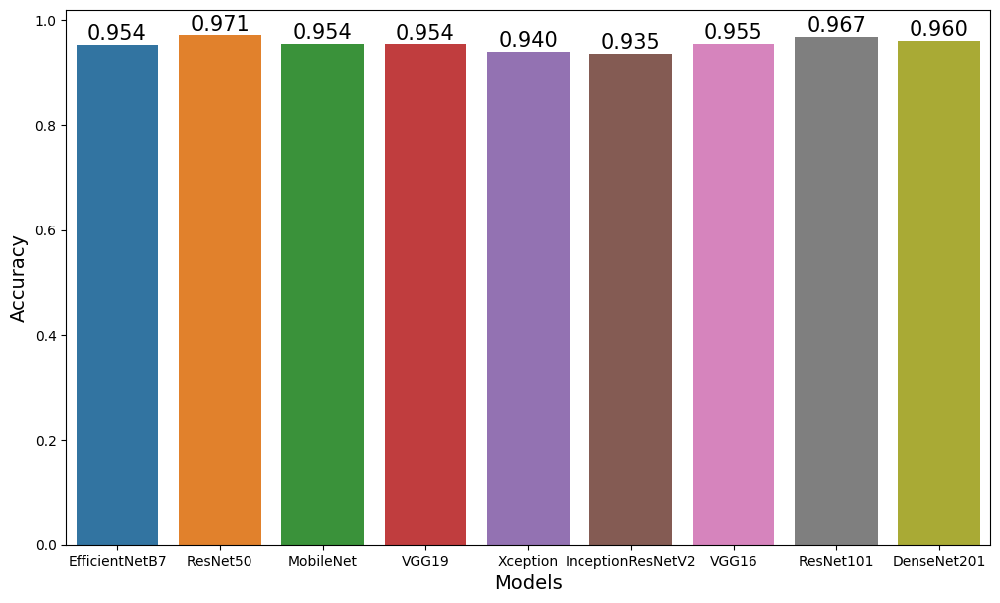

In [75]:
plt.figure(figsize=(12, 7))
plots = sns.barplot(x='Model', y='Accuracy', data=output)
for bar in plots.patches:
    plots.annotate(format(bar.get_height(), '.3f'),
                   (bar.get_x() + bar.get_width() / 2,
                    bar.get_height()), ha='center', va='center',
                   size=15, xytext=(0, 8),
                   textcoords='offset points')

plt.xlabel("Models", size=14)
plt.ylabel("Accuracy", size=14)
plt.show()

## 🦾 5.4 Optimisation ViT et du meilleur CNN

### ✔️ 5.4.1 ViT

#### 5.4.1.1 Définition des hyperparamètres

In [85]:
list_batch_size_ViT= [50, 300]
list_num_epochs_ViT= [50, 200]

#### 5.4.1.2 Chargement du modèle

In [86]:
def run_experiment2(model, batch_size, num_epochs):
    optimizer = tfa.optimizers.AdamW(
        learning_rate=learning_rate, weight_decay=weight_decay
    )

    model.compile(
        optimizer=optimizer,
        loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
        metrics=[
            tf.keras.metrics.SparseCategoricalAccuracy(name="accuracy"),
            tf.keras.metrics.SparseTopKCategoricalAccuracy(5, name="top-5-accuracy"),
        ],
    )

    checkpoint_filepath = "./tmp/checkpoint"
    checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
        checkpoint_filepath,
        monitor="val_accuracy",
        save_best_only=True,
        save_weights_only=True,
    )

    start = time.time()
    history = model.fit(
        x=x_train,
        y=y_train,
        batch_size=batch_size,
        epochs=num_epochs,
        validation_data=(x_test, y_test),
        callbacks=[checkpoint_callback],
    )
    end = time.time()
    print("Batch size =",batch_size)
    print("Num Epoch =",num_epochs)
    print("Temps d'entrainement =",(format(((end-start)/60)/60),"heures"))

    model.load_weights(checkpoint_filepath)
    _, accuracy, top_5_accuracy = model.evaluate(x_test, y_test)
    print(f"Test accuracy: {round(accuracy * 100, 2)}%")
    print(f"Test top 5 accuracy: {round(top_5_accuracy * 100, 2)}%")
    
    #model.save('./modeles/fire_detection_120_120/ViT_fire_120_120.h5')
    #print('Model ViT enregistré!')

    return history, model

In [87]:
vit_classifier_opt = create_vit_classifier()

for batch_size in list_batch_size_ViT :
    for num_epochs in list_num_epochs_ViT :
        ViT_history_opt, model_ViT_opt = run_experiment2(vit_classifier_opt, batch_size, num_epochs)

Epoch 1/50
686/686 [==============================] - 482s 447ms/step - loss: 0.3144 - accuracy: 0.8968 - top-5-accuracy: 1.0000 - val_loss: 0.1795 - val_accuracy: 0.9341 - val_top-5-accuracy: 1.0000
Epoch 2/50
686/686 [==============================] - 293s 427ms/step - loss: 0.1921 - accuracy: 0.9284 - top-5-accuracy: 1.0000 - val_loss: 0.1387 - val_accuracy: 0.9469 - val_top-5-accuracy: 1.0000
Epoch 3/50
686/686 [==============================] - 288s 420ms/step - loss: 0.1797 - accuracy: 0.9344 - top-5-accuracy: 1.0000 - val_loss: 0.1757 - val_accuracy: 0.9284 - val_top-5-accuracy: 1.0000
Epoch 4/50
686/686 [==============================] - 317s 462ms/step - loss: 0.1643 - accuracy: 0.9400 - top-5-accuracy: 1.0000 - val_loss: 0.1550 - val_accuracy: 0.9431 - val_top-5-accuracy: 1.0000
Epoch 5/50
686/686 [==============================] - 376s 548ms/step - loss: 0.1557 - accuracy: 0.9428 - top-5-accuracy: 1.0000 - val_loss: 0.1220 - val_accuracy: 0.9548 - val_top-5-accuracy: 1.0000


### ✔️ 5.4.2 Resnet50

In [88]:
list_num_epochs_Resnet50= [20, 50, 200]

Found 27424 validated image filenames belonging to 2 classes.
Found 6856 validated image filenames belonging to 2 classes.
Found 8570 validated image filenames belonging to 2 classes.
Epoch = 20
Temps d'entrainement = ('1.2369851263364156', 'heures')
268/268 [==============================] - 244s 584ms/step
              precision    recall  f1-score   support

          no       0.97      0.97      0.97      4028
         yes       0.97      0.98      0.97      4542

    accuracy                           0.97      8570
   macro avg       0.97      0.97      0.97      8570
weighted avg       0.97      0.97      0.97      8570



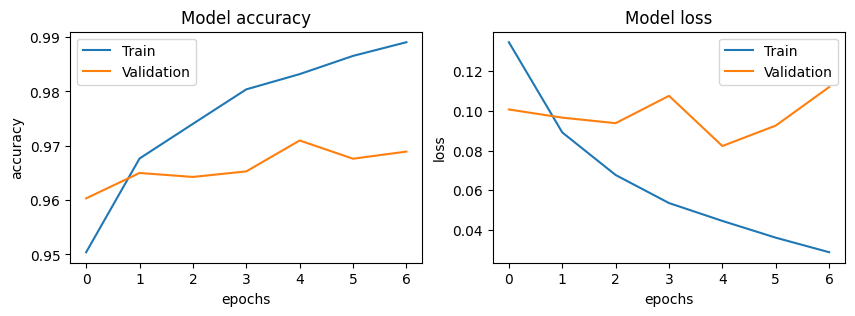

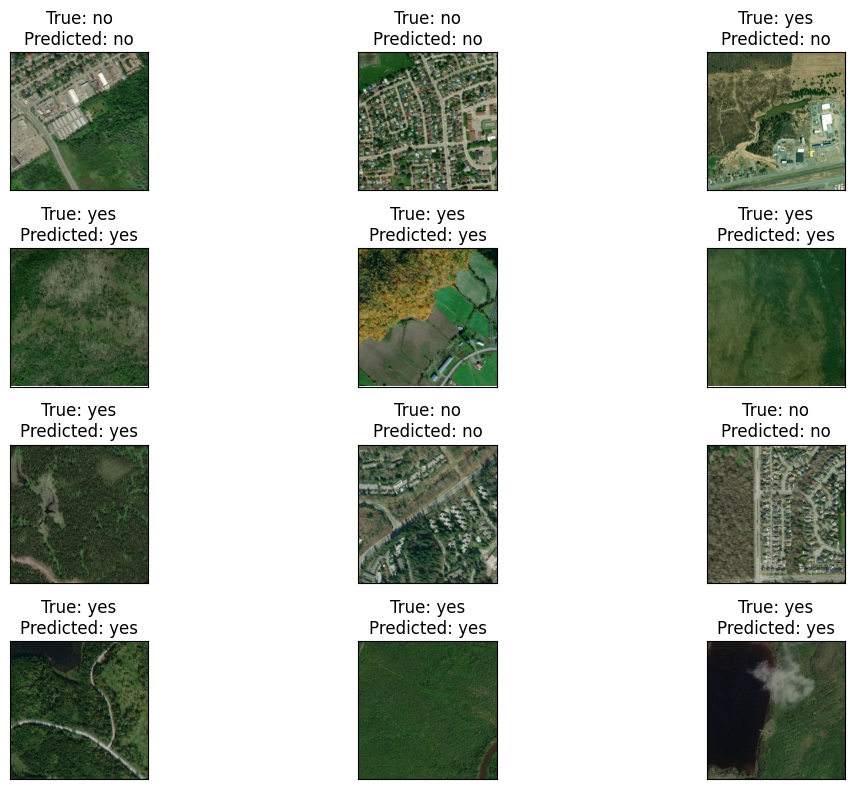

    Test Loss: 0.10189
Test Accuracy: 97.13%
Epoch = 50
Temps d'entrainement = ('0.5261671335167355', 'heures')
268/268 [==============================] - 156s 583ms/step
              precision    recall  f1-score   support

          no       0.95      0.98      0.97      4028
         yes       0.98      0.96      0.97      4542

    accuracy                           0.97      8570
   macro avg       0.97      0.97      0.97      8570
weighted avg       0.97      0.97      0.97      8570



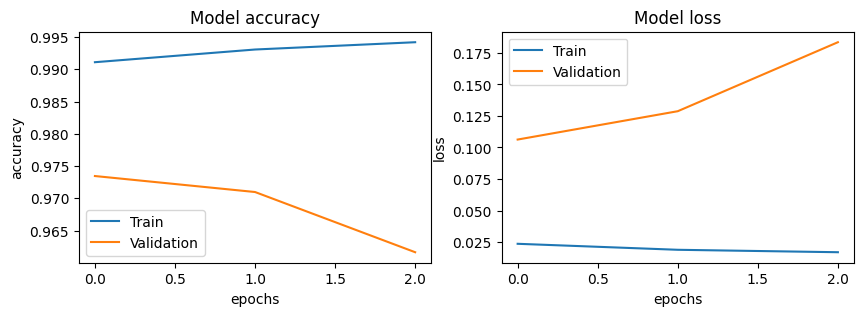

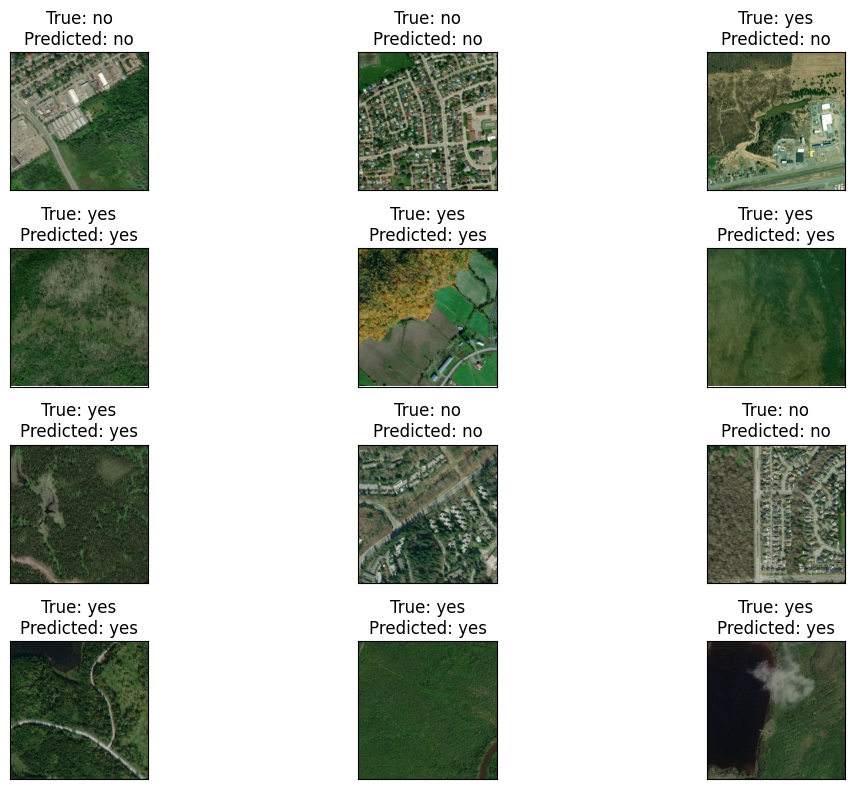

    Test Loss: 0.13511
Test Accuracy: 96.77%
Epoch = 200
Temps d'entrainement = ('0.689448607299063', 'heures')
268/268 [==============================] - 156s 580ms/step
              precision    recall  f1-score   support

          no       0.97      0.97      0.97      4028
         yes       0.97      0.97      0.97      4542

    accuracy                           0.97      8570
   macro avg       0.97      0.97      0.97      8570
weighted avg       0.97      0.97      0.97      8570



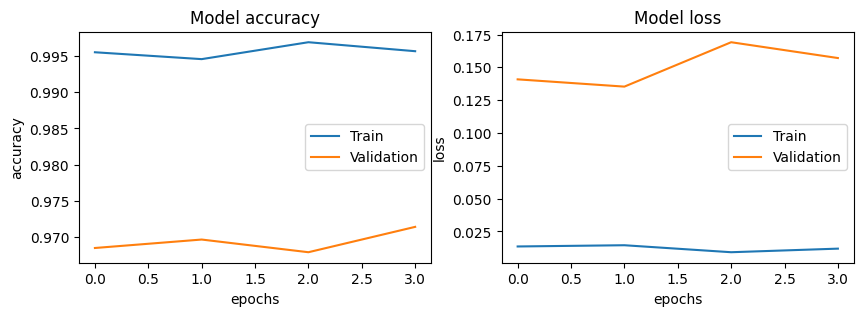

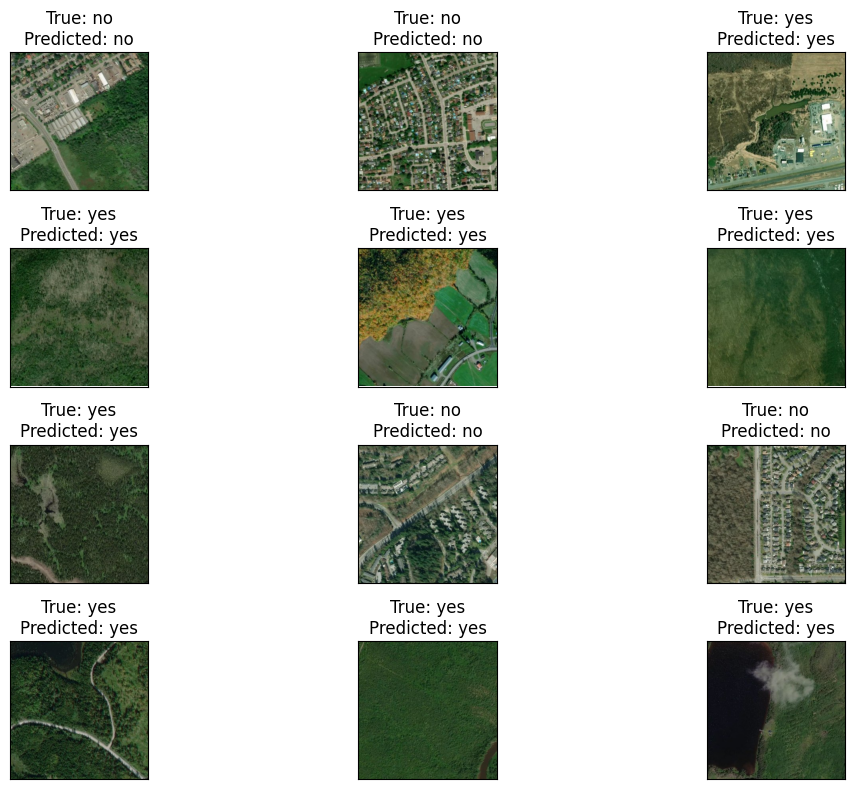

    Test Loss: 0.15606
Test Accuracy: 97.05%


In [89]:
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.applications.resnet50 import preprocess_input

ResNet_pre=preprocess_input
train_gen_ResNet, valid_gen_ResNet, test_gen_ResNet = gen(ResNet_pre,train_df,test_df)
ResNet_model, callback=func(ResNet50)

for epochs in list_num_epochs_Resnet50 :
    start = time.time()
    history = ResNet_model.fit(
        train_gen_ResNet,
        validation_data=valid_gen_ResNet,
        epochs=epochs,
        callbacks=callback,
        verbose=0
    )
    end = time.time()
    print("Epoch =", epochs)
    print("Temps d'entrainement =",(format(((end-start)/60)/60),"heures"))
    history_ResNet_opt= plot(history,test_gen_ResNet,train_gen_ResNet, ResNet_model)
    result_ResNet_opt = result_test(test_gen_ResNet,ResNet_model)

In [ ]:
#Optimisation CNN avec Grid Search CV

In [21]:
def gen2(pre,train,test, batch_size):
    train_datagen = ImageDataGenerator(preprocessing_function=pre, validation_split=0.2)
    test_datagen = ImageDataGenerator(preprocessing_function=pre)
    
    train_gen = train_datagen.flow_from_dataframe(
        dataframe=train,
        x_col='File_Path',
        y_col='Labels',
        target_size=(120,120),
        class_mode='categorical',
        batch_size=batch_size,
        shuffle=True,
        seed=0,
        subset='training',
        rotation_range=30,
        zoom_range=0.15,
        width_shift_range=0.2,
        height_shift_range=0.2,
        shear_range=0.15,
        horizontal_flip=True,
        fill_mode="nearest")
    valid_gen = train_datagen.flow_from_dataframe(
        dataframe=train,
        x_col='File_Path',
        y_col='Labels',
        target_size=(120,120),
        class_mode='categorical',
        batch_size=batch_size,
        shuffle=False,
        seed=0,
        subset='validation',
        rotation_range=30,
        zoom_range=0.15,
        width_shift_range=0.2,
        height_shift_range=0.2,
        shear_range=0.15,
        horizontal_flip=True,
        fill_mode="nearest")
    test_gen = test_datagen.flow_from_dataframe(
        dataframe=test,
        x_col='File_Path',
        y_col='Labels',
        target_size=(120,120),
        color_mode='rgb',
        class_mode='categorical',
        batch_size=batch_size,
        verbose=0,
        shuffle=False)
    return train_gen, valid_gen, test_gen


In [53]:
list_num_epochs_Resnet50= [20, 50, 100, 200]
list_num_batchs_Resnet50= [20, 50, 100, 256]

Found 27424 validated image filenames belonging to 2 classes.
Found 6856 validated image filenames belonging to 2 classes.
Found 8570 validated image filenames belonging to 2 classes.
Batch = 20
Epoch = 20
Epoch 1/20
1372/1372 [==============================] - 621s 450ms/step - loss: 0.1325 - accuracy: 0.9516 - val_loss: 0.0950 - val_accuracy: 0.9647
Epoch 2/20
1372/1372 [==============================] - 605s 441ms/step - loss: 0.0877 - accuracy: 0.9678 - val_loss: 0.0923 - val_accuracy: 0.9656
Epoch 3/20
1372/1372 [==============================] - 616s 449ms/step - loss: 0.0692 - accuracy: 0.9736 - val_loss: 0.0920 - val_accuracy: 0.9670
Epoch 4/20
1372/1372 [==============================] - 609s 444ms/step - loss: 0.0550 - accuracy: 0.9794 - val_loss: 0.0911 - val_accuracy: 0.9702
Epoch 5/20
1372/1372 [==============================] - 617s 450ms/step - loss: 0.0460 - accuracy: 0.9832 - val_loss: 0.1118 - val_accuracy: 0.9659
Epoch 6/20
1372/1372 [==============================] 

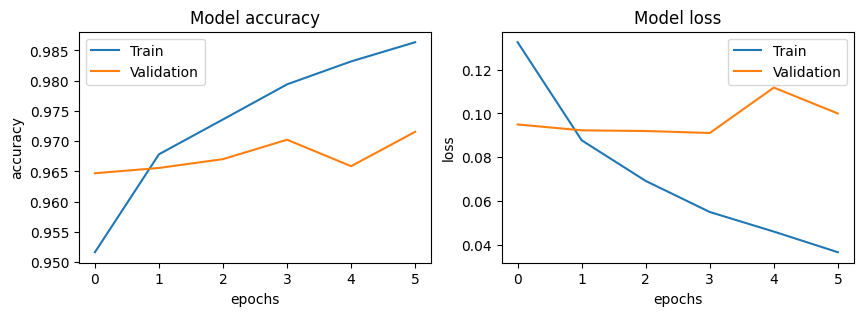

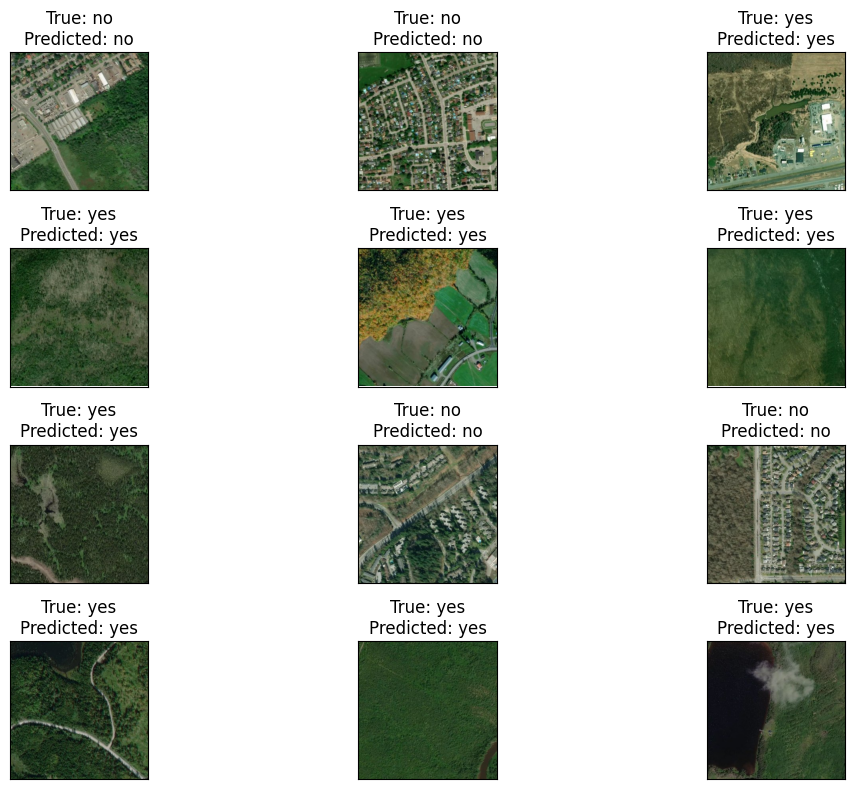

    Test Loss: 0.09605
Test Accuracy: 96.91%
##########################################
Batch = 20
Epoch = 50
Epoch 1/50
1372/1372 [==============================] - 624s 455ms/step - loss: 0.0265 - accuracy: 0.9904 - val_loss: 0.1087 - val_accuracy: 0.9729
Epoch 2/50
1372/1372 [==============================] - 612s 446ms/step - loss: 0.0245 - accuracy: 0.9918 - val_loss: 0.1113 - val_accuracy: 0.9730
Epoch 3/50
1372/1372 [==============================] - 648s 472ms/step - loss: 0.0194 - accuracy: 0.9932 - val_loss: 0.1227 - val_accuracy: 0.9705
Model CNN enregistré avec les paramètres : batchs= 20 epochs= 50
##########################################
Batch = 20
Epoch = 50
Temps d'entrainement = ('0.5232711872127321', 'heures')
429/429 [==============================] - 152s 354ms/step
              precision    recall  f1-score   support

          no       0.96      0.97      0.97      4028
         yes       0.97      0.97      0.97      4542

    accuracy                         

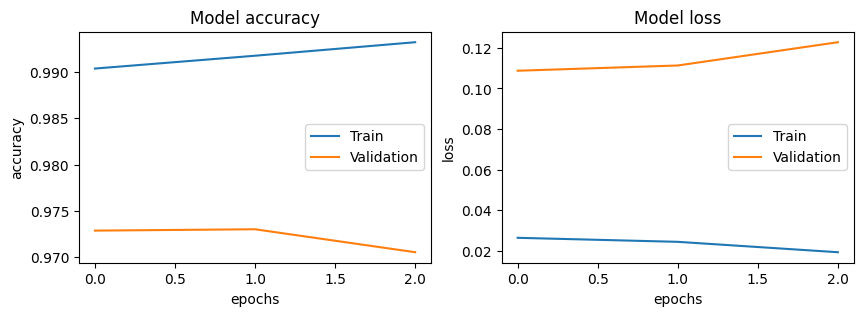

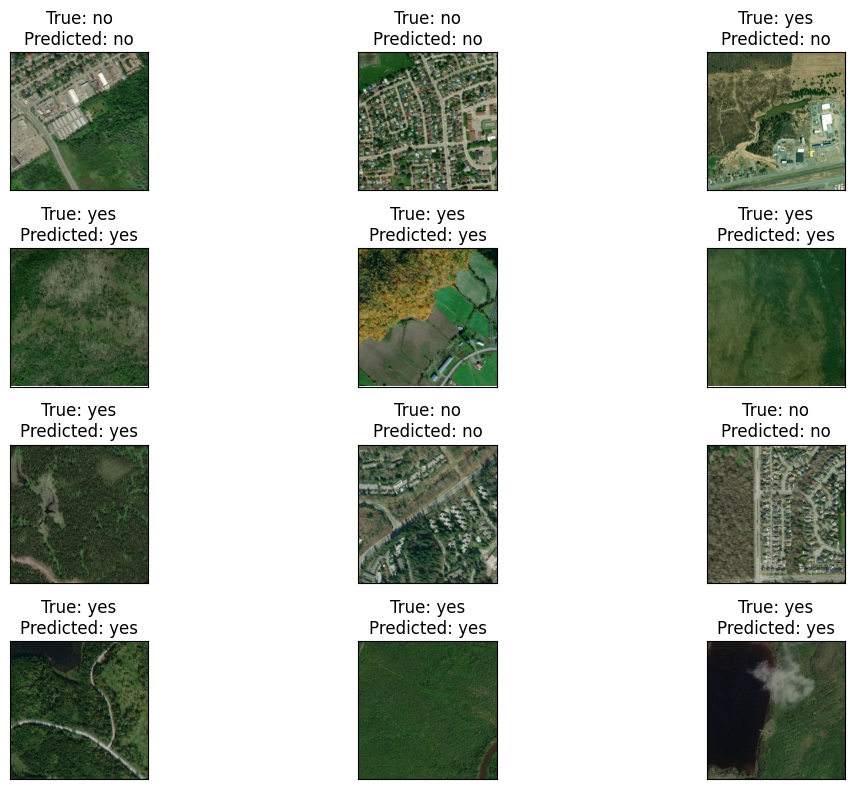

    Test Loss: 0.11502
Test Accuracy: 96.80%
##########################################
Batch = 20
Epoch = 100
Epoch 1/100
1372/1372 [==============================] - 604s 440ms/step - loss: 0.0158 - accuracy: 0.9945 - val_loss: 0.1349 - val_accuracy: 0.9695
Epoch 2/100
1372/1372 [==============================] - 594s 433ms/step - loss: 0.0163 - accuracy: 0.9943 - val_loss: 0.1241 - val_accuracy: 0.9721
Epoch 3/100
1372/1372 [==============================] - 606s 442ms/step - loss: 0.0128 - accuracy: 0.9953 - val_loss: 0.1423 - val_accuracy: 0.9697
Epoch 4/100
1372/1372 [==============================] - 648s 472ms/step - loss: 0.0126 - accuracy: 0.9958 - val_loss: 0.1630 - val_accuracy: 0.9717
Model CNN enregistré avec les paramètres : batchs= 20 epochs= 100
##########################################
Batch = 20
Epoch = 100
Temps d'entrainement = ('0.6814342674944136', 'heures')
429/429 [==============================] - 159s 371ms/step
              precision    recall  f1-score   

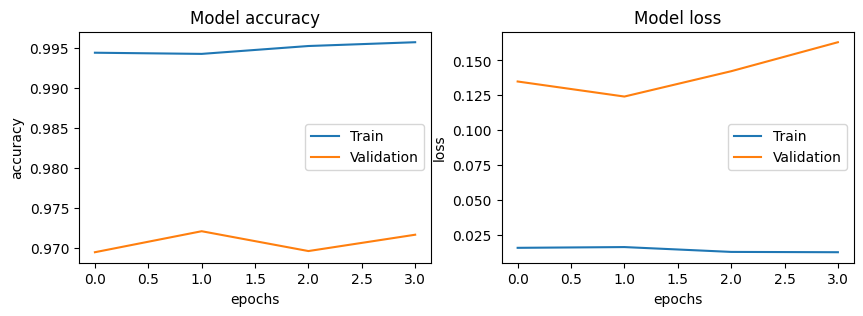

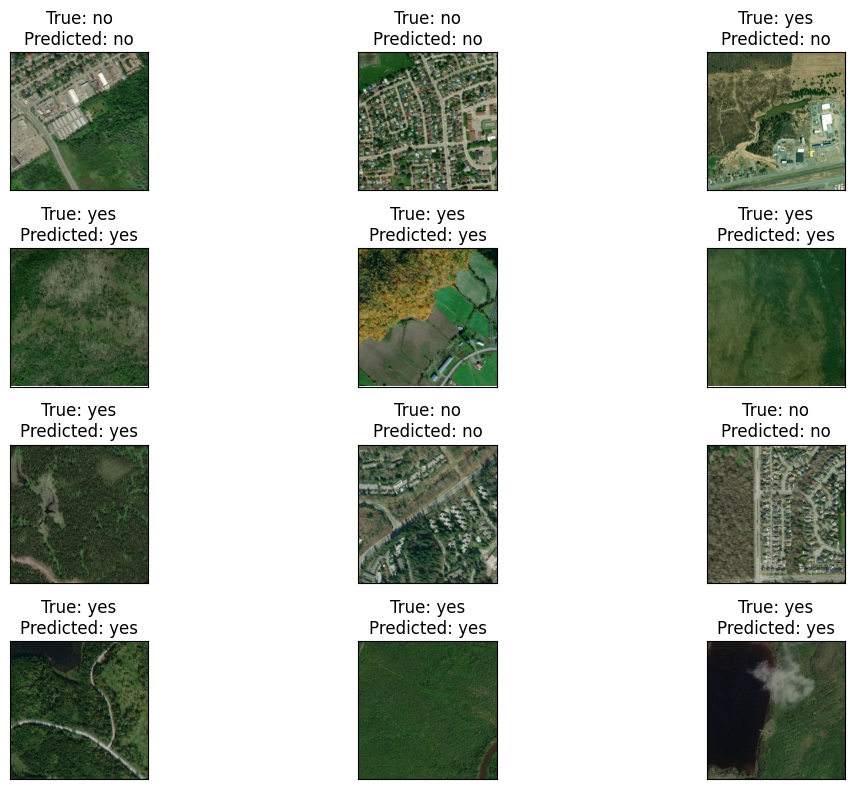

    Test Loss: 0.16547
Test Accuracy: 97.16%
##########################################
Batch = 20
Epoch = 200
Epoch 1/200
1372/1372 [==============================] - 578s 421ms/step - loss: 0.0114 - accuracy: 0.9963 - val_loss: 0.1795 - val_accuracy: 0.9700
Epoch 2/200
1372/1372 [==============================] - 577s 421ms/step - loss: 0.0070 - accuracy: 0.9978 - val_loss: 0.1735 - val_accuracy: 0.9718
Epoch 3/200
1372/1372 [==============================] - 602s 439ms/step - loss: 0.0092 - accuracy: 0.9968 - val_loss: 0.1512 - val_accuracy: 0.9692
Epoch 4/200
1372/1372 [==============================] - 577s 421ms/step - loss: 0.0112 - accuracy: 0.9961 - val_loss: 0.1534 - val_accuracy: 0.9717
Epoch 5/200
1372/1372 [==============================] - 571s 416ms/step - loss: 0.0082 - accuracy: 0.9973 - val_loss: 0.2031 - val_accuracy: 0.9689
Model CNN enregistré avec les paramètres : batchs= 20 epochs= 200
##########################################
Batch = 20
Epoch = 200
Temps d'entr

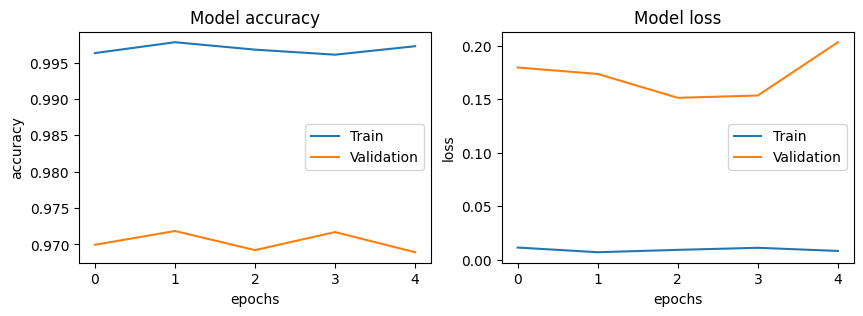

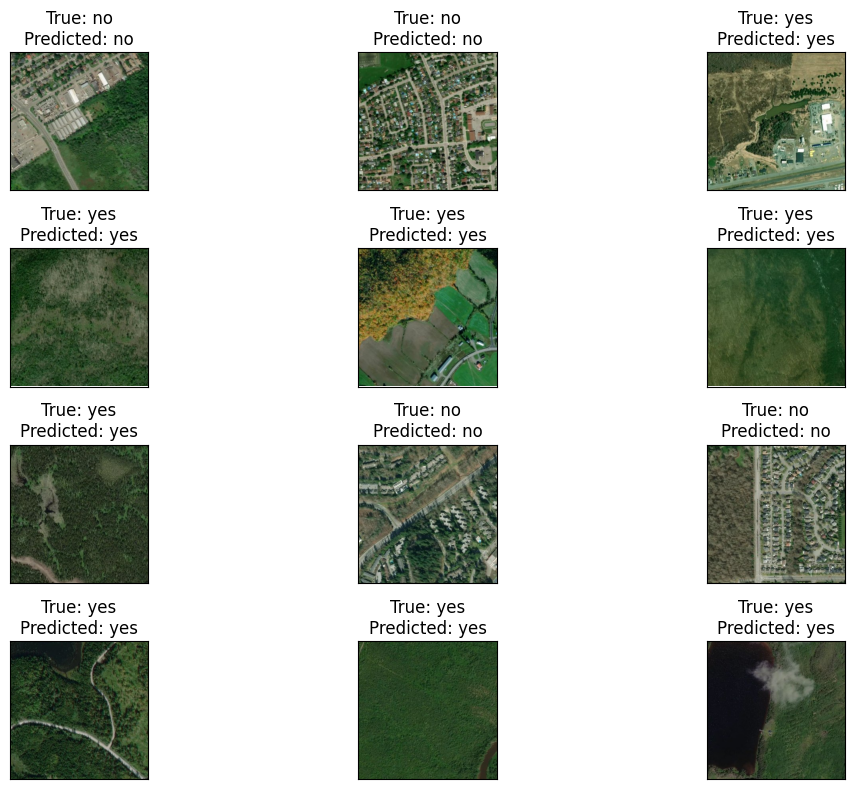

    Test Loss: 0.19054
Test Accuracy: 96.97%
##########################################
Found 27424 validated image filenames belonging to 2 classes.
Found 6856 validated image filenames belonging to 2 classes.
Found 8570 validated image filenames belonging to 2 classes.
Batch = 50
Epoch = 20
Epoch 1/20
549/549 [==============================] - 521s 943ms/step - loss: 0.1383 - accuracy: 0.9480 - val_loss: 0.0985 - val_accuracy: 0.9632
Epoch 2/20
549/549 [==============================] - 518s 943ms/step - loss: 0.0895 - accuracy: 0.9671 - val_loss: 0.0869 - val_accuracy: 0.9675
Epoch 3/20
549/549 [==============================] - 523s 953ms/step - loss: 0.0645 - accuracy: 0.9754 - val_loss: 0.0803 - val_accuracy: 0.9723
Epoch 4/20
549/549 [==============================] - 523s 954ms/step - loss: 0.0510 - accuracy: 0.9800 - val_loss: 0.0987 - val_accuracy: 0.9702
Epoch 5/20
549/549 [==============================] - 523s 954ms/step - loss: 0.0390 - accuracy: 0.9855 - val_loss: 0.0897

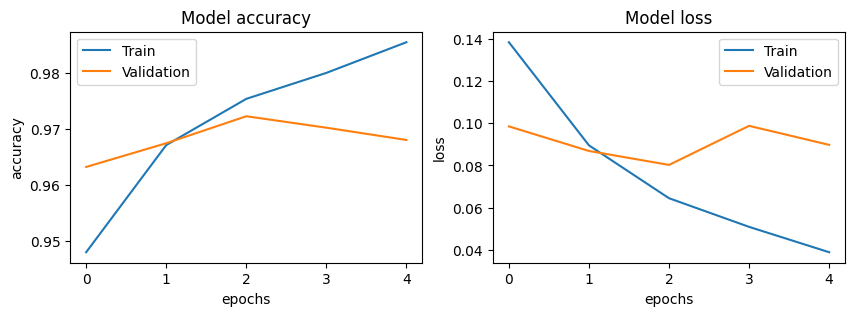

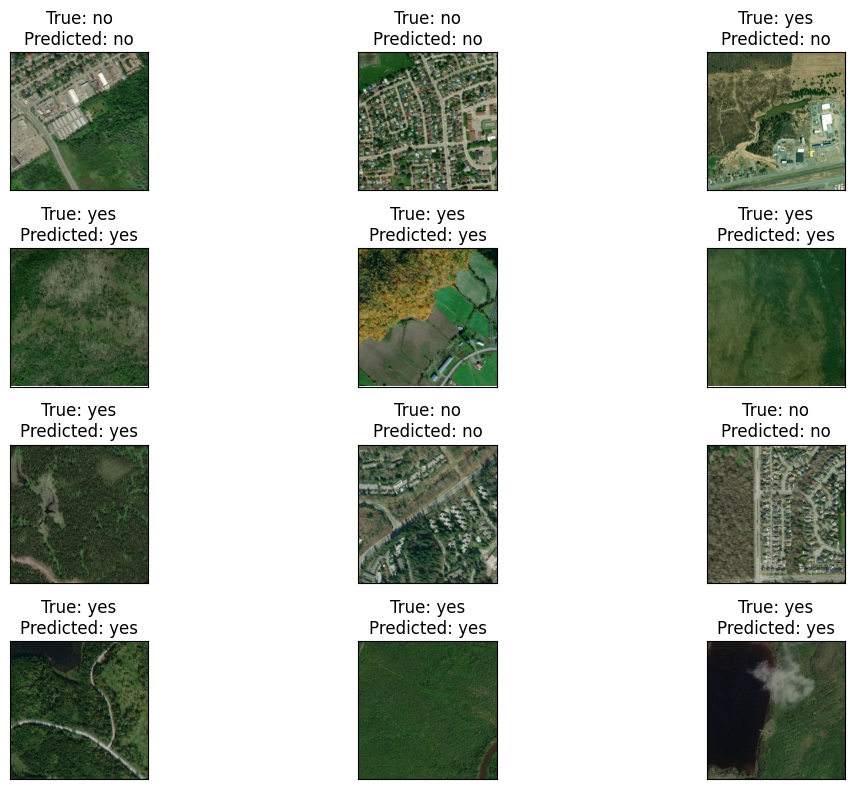

    Test Loss: 0.08580
Test Accuracy: 96.86%
##########################################
Batch = 50
Epoch = 50
Epoch 1/50
549/549 [==============================] - 517s 942ms/step - loss: 0.0293 - accuracy: 0.9895 - val_loss: 0.1029 - val_accuracy: 0.9730
Epoch 2/50
549/549 [==============================] - 517s 941ms/step - loss: 0.0265 - accuracy: 0.9897 - val_loss: 0.1031 - val_accuracy: 0.9704
Epoch 3/50
549/549 [==============================] - 520s 948ms/step - loss: 0.0203 - accuracy: 0.9934 - val_loss: 0.1080 - val_accuracy: 0.9697
Model CNN enregistré avec les paramètres : batchs= 50 epochs= 50
##########################################
Batch = 50
Epoch = 50
Temps d'entrainement = ('0.43171293742126887', 'heures')
172/172 [==============================] - 129s 750ms/step
              precision    recall  f1-score   support

          no       0.97      0.96      0.97      4028
         yes       0.97      0.98      0.97      4542

    accuracy                           0.9

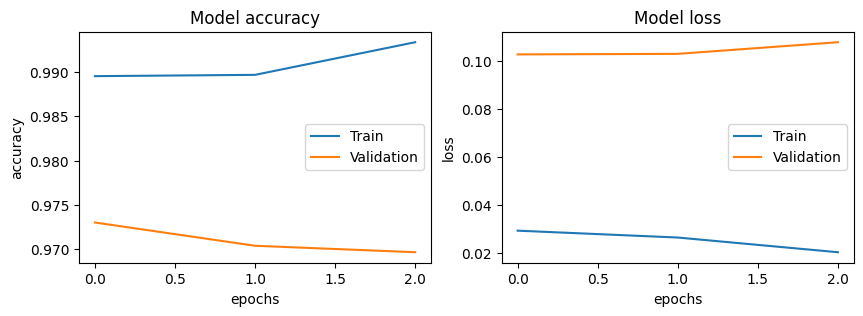

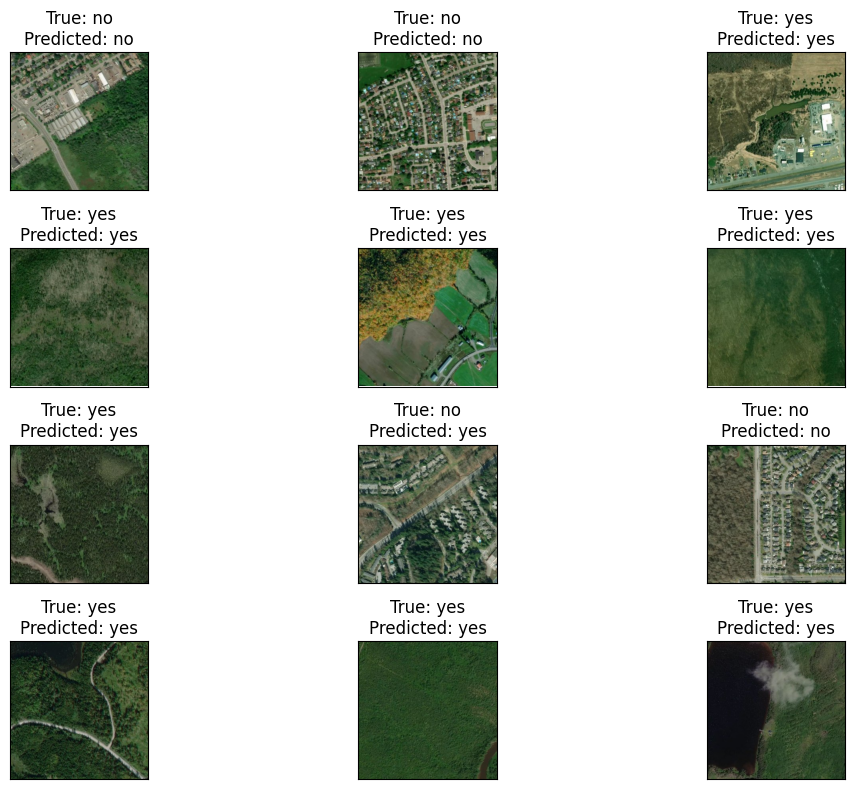

    Test Loss: 0.10251
Test Accuracy: 97.09%
##########################################
Batch = 50
Epoch = 100
Epoch 1/100
549/549 [==============================] - 515s 938ms/step - loss: 0.0143 - accuracy: 0.9951 - val_loss: 0.1295 - val_accuracy: 0.9740
Epoch 2/100
549/549 [==============================] - 533s 971ms/step - loss: 0.0182 - accuracy: 0.9937 - val_loss: 0.1279 - val_accuracy: 0.9710
Epoch 3/100
549/549 [==============================] - 575s 1s/step - loss: 0.0144 - accuracy: 0.9947 - val_loss: 0.1344 - val_accuracy: 0.9686
Epoch 4/100
549/549 [==============================] - 551s 1s/step - loss: 0.0092 - accuracy: 0.9970 - val_loss: 0.1285 - val_accuracy: 0.9723
Model CNN enregistré avec les paramètres : batchs= 50 epochs= 100
##########################################
Batch = 50
Epoch = 100
Temps d'entrainement = ('0.6038980539639791', 'heures')
172/172 [==============================] - 132s 766ms/step
              precision    recall  f1-score   support

     

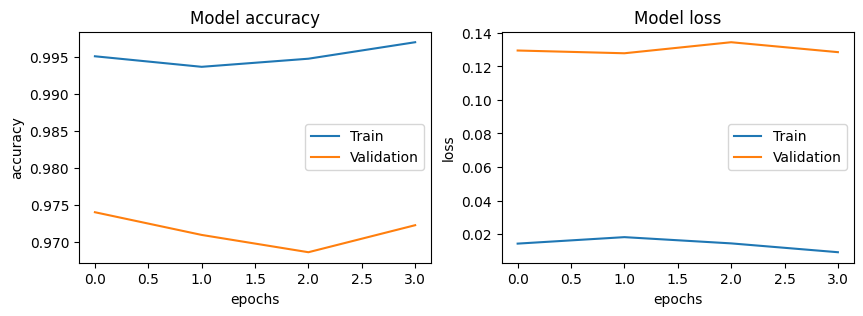

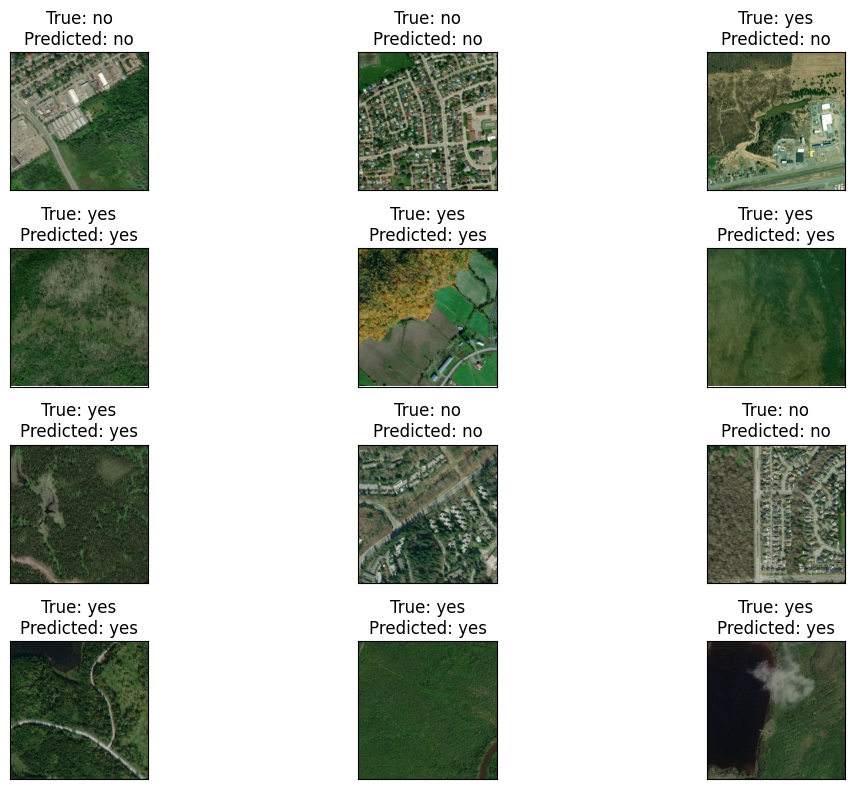

    Test Loss: 0.11439
Test Accuracy: 97.47%
##########################################
Batch = 50
Epoch = 200
Epoch 1/200
549/549 [==============================] - 524s 954ms/step - loss: 0.0053 - accuracy: 0.9979 - val_loss: 0.1476 - val_accuracy: 0.9724
Epoch 2/200
549/549 [==============================] - 524s 956ms/step - loss: 0.0151 - accuracy: 0.9942 - val_loss: 0.1452 - val_accuracy: 0.9735
Epoch 3/200
549/549 [==============================] - 524s 955ms/step - loss: 0.0068 - accuracy: 0.9978 - val_loss: 0.1508 - val_accuracy: 0.9721
Epoch 4/200
549/549 [==============================] - 522s 950ms/step - loss: 0.0095 - accuracy: 0.9963 - val_loss: 0.1589 - val_accuracy: 0.9700
Model CNN enregistré avec les paramètres : batchs= 50 epochs= 200
##########################################
Batch = 50
Epoch = 200
Temps d'entrainement = ('0.5817212174336116', 'heures')
172/172 [==============================] - 129s 750ms/step
              precision    recall  f1-score   support


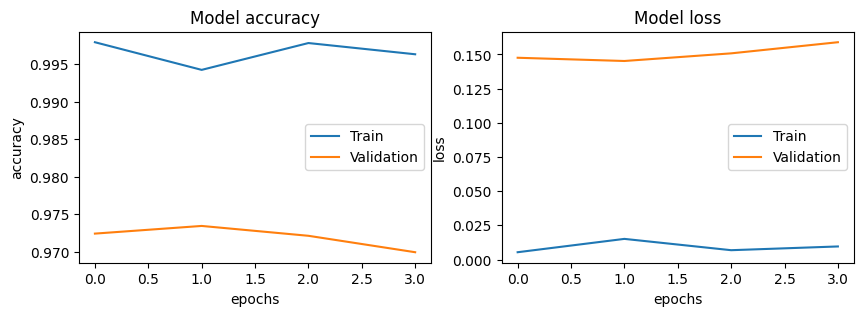

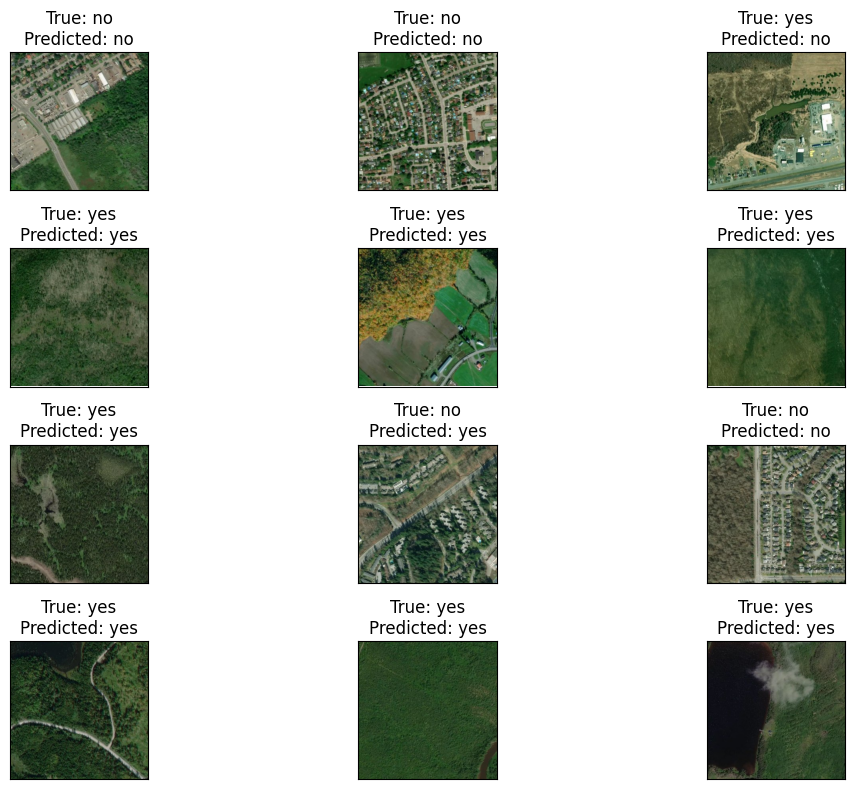

    Test Loss: 0.13884
Test Accuracy: 97.28%
##########################################
Found 27424 validated image filenames belonging to 2 classes.
Found 6856 validated image filenames belonging to 2 classes.
Found 8570 validated image filenames belonging to 2 classes.
Batch = 100
Epoch = 20
Epoch 1/20
275/275 [==============================] - 493s 2s/step - loss: 0.1349 - accuracy: 0.9495 - val_loss: 0.0945 - val_accuracy: 0.9662
Epoch 2/20
275/275 [==============================] - 490s 2s/step - loss: 0.0816 - accuracy: 0.9692 - val_loss: 0.0988 - val_accuracy: 0.9653
Epoch 3/20
275/275 [==============================] - 491s 2s/step - loss: 0.0603 - accuracy: 0.9778 - val_loss: 0.0833 - val_accuracy: 0.9689
Epoch 4/20
275/275 [==============================] - 489s 2s/step - loss: 0.0453 - accuracy: 0.9827 - val_loss: 0.1264 - val_accuracy: 0.9638
Epoch 5/20
275/275 [==============================] - 491s 2s/step - loss: 0.0326 - accuracy: 0.9881 - val_loss: 0.1016 - val_accurac

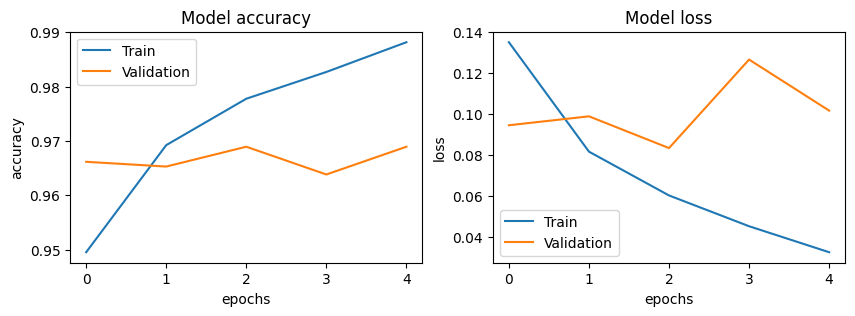

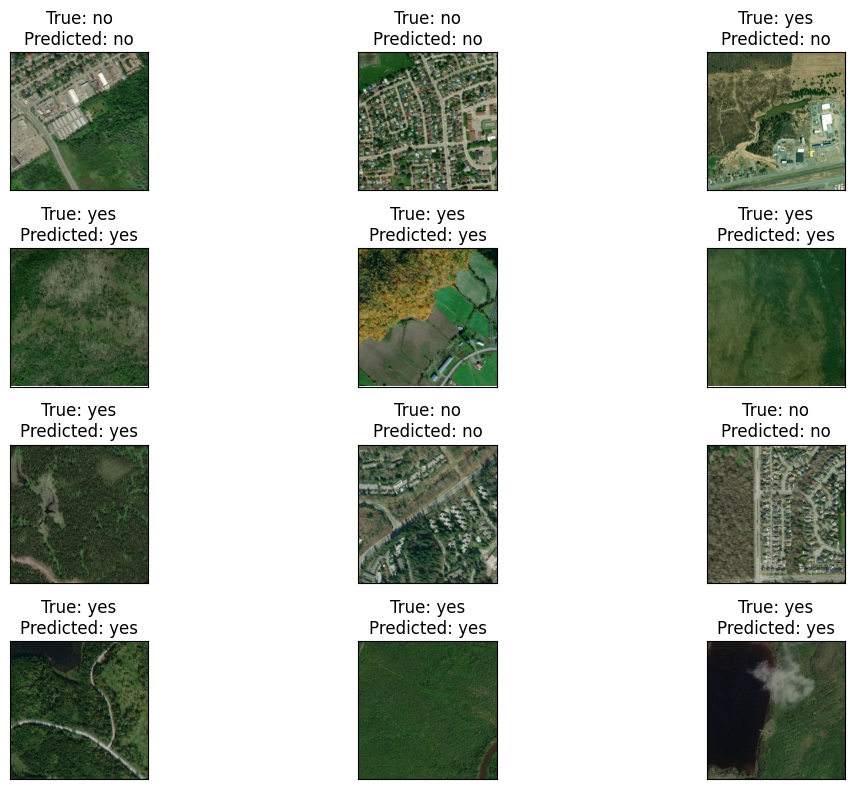

    Test Loss: 0.08579
Test Accuracy: 97.06%
##########################################
Batch = 100
Epoch = 50
Epoch 1/50
275/275 [==============================] - 485s 2s/step - loss: 0.0242 - accuracy: 0.9912 - val_loss: 0.1000 - val_accuracy: 0.9681
Epoch 2/50
275/275 [==============================] - 485s 2s/step - loss: 0.0181 - accuracy: 0.9934 - val_loss: 0.1007 - val_accuracy: 0.9682
Epoch 3/50
275/275 [==============================] - 487s 2s/step - loss: 0.0165 - accuracy: 0.9940 - val_loss: 0.1365 - val_accuracy: 0.9695
Model CNN enregistré avec les paramètres : batchs= 100 epochs= 50
##########################################
Batch = 100
Epoch = 50
Temps d'entrainement = ('0.40470000167687736', 'heures')
86/86 [==============================] - 123s 1s/step
              precision    recall  f1-score   support

          no       0.98      0.96      0.97      4028
         yes       0.96      0.98      0.97      4542

    accuracy                           0.97      8570

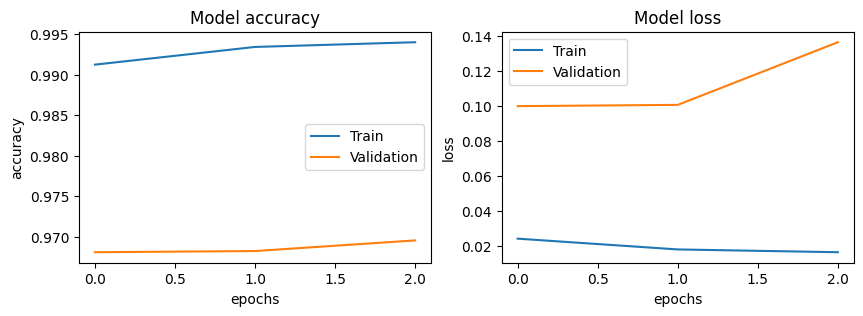

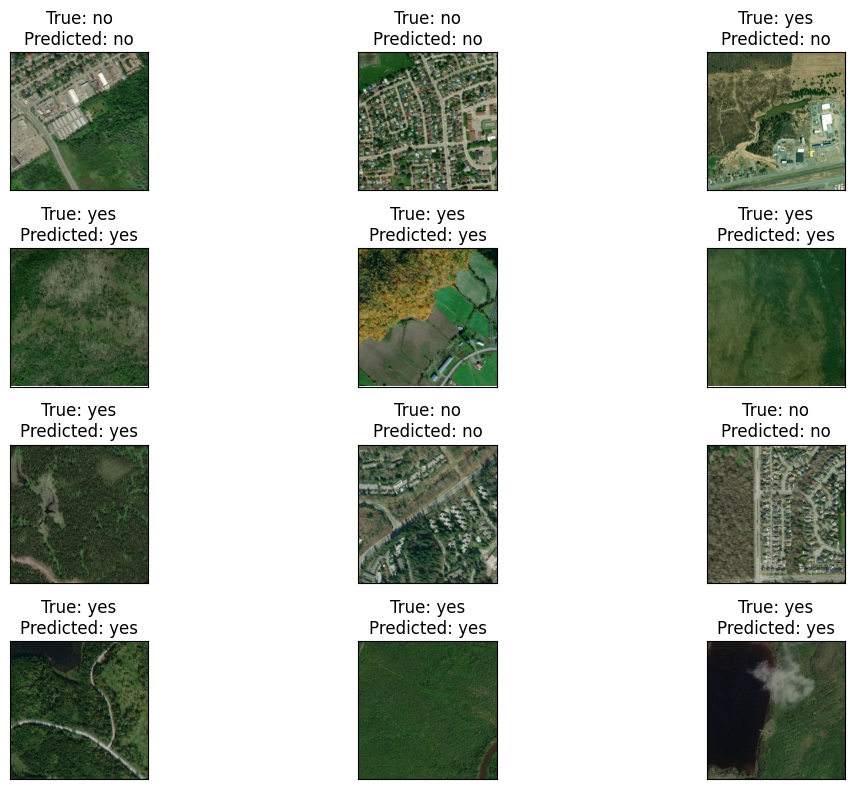

    Test Loss: 0.12313
Test Accuracy: 97.02%
##########################################
Batch = 100
Epoch = 100
Epoch 1/100
275/275 [==============================] - 484s 2s/step - loss: 0.0138 - accuracy: 0.9948 - val_loss: 0.1087 - val_accuracy: 0.9740
Epoch 2/100
275/275 [==============================] - 483s 2s/step - loss: 0.0118 - accuracy: 0.9957 - val_loss: 0.1090 - val_accuracy: 0.9724
Epoch 3/100
275/275 [==============================] - 487s 2s/step - loss: 0.0127 - accuracy: 0.9954 - val_loss: 0.1438 - val_accuracy: 0.9705
Model CNN enregistré avec les paramètres : batchs= 100 epochs= 100
##########################################
Batch = 100
Epoch = 100
Temps d'entrainement = ('0.40388571242491406', 'heures')
86/86 [==============================] - 120s 1s/step
              precision    recall  f1-score   support

          no       0.96      0.98      0.97      4028
         yes       0.98      0.97      0.97      4542

    accuracy                           0.97    

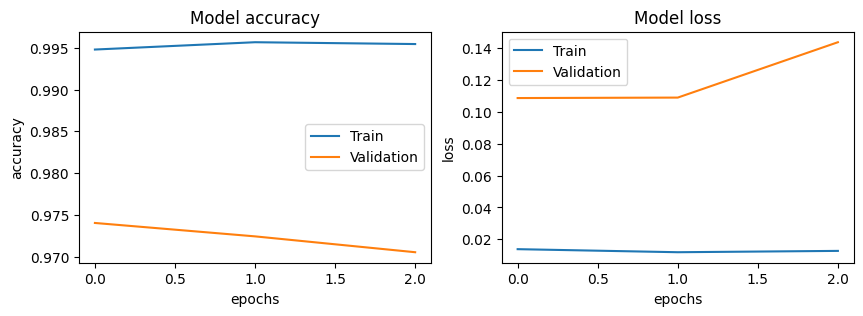

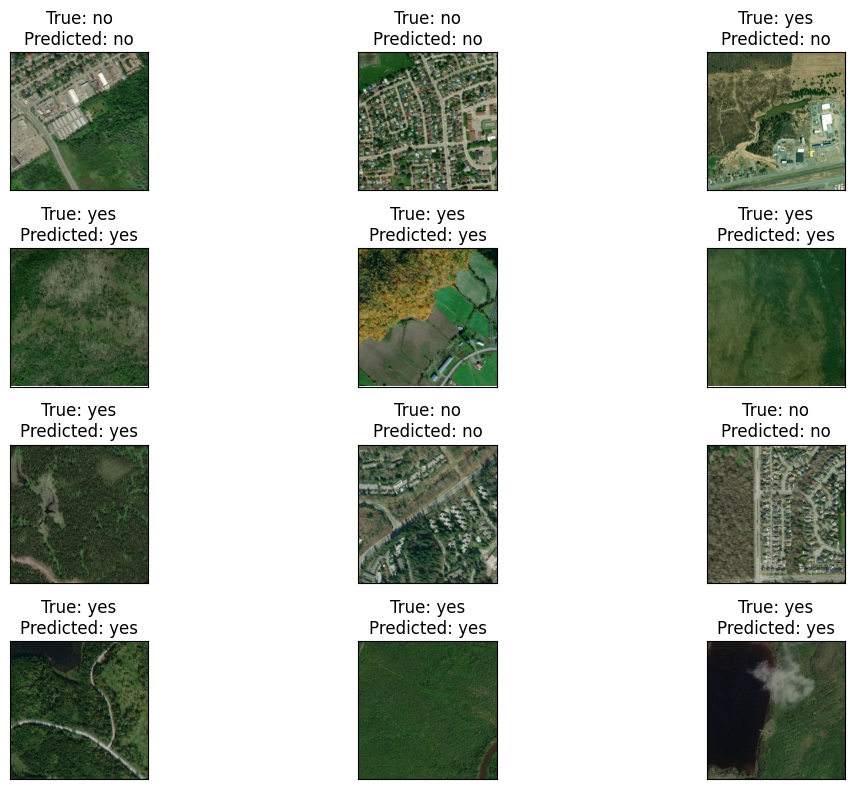

    Test Loss: 0.13224
Test Accuracy: 97.27%
##########################################
Batch = 100
Epoch = 200
Epoch 1/200
275/275 [==============================] - 485s 2s/step - loss: 0.0080 - accuracy: 0.9972 - val_loss: 0.1476 - val_accuracy: 0.9713
Epoch 2/200
275/275 [==============================] - 483s 2s/step - loss: 0.0081 - accuracy: 0.9968 - val_loss: 0.1438 - val_accuracy: 0.9702
Epoch 3/200
275/275 [==============================] - 486s 2s/step - loss: 0.0104 - accuracy: 0.9965 - val_loss: 0.1340 - val_accuracy: 0.9740
Epoch 4/200
275/275 [==============================] - 485s 2s/step - loss: 0.0054 - accuracy: 0.9984 - val_loss: 0.1384 - val_accuracy: 0.9768
Epoch 5/200
275/275 [==============================] - 486s 2s/step - loss: 8.9580e-04 - accuracy: 0.9999 - val_loss: 0.1485 - val_accuracy: 0.9756
Model CNN enregistré avec les paramètres : batchs= 100 epochs= 200
##########################################
Batch = 100
Epoch = 200
Temps d'entrainement = ('0.673

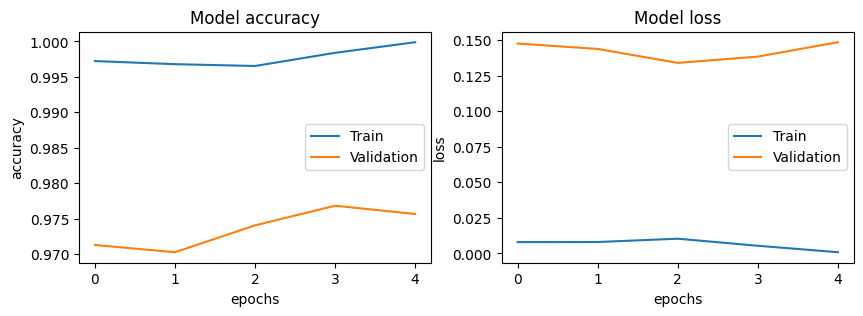

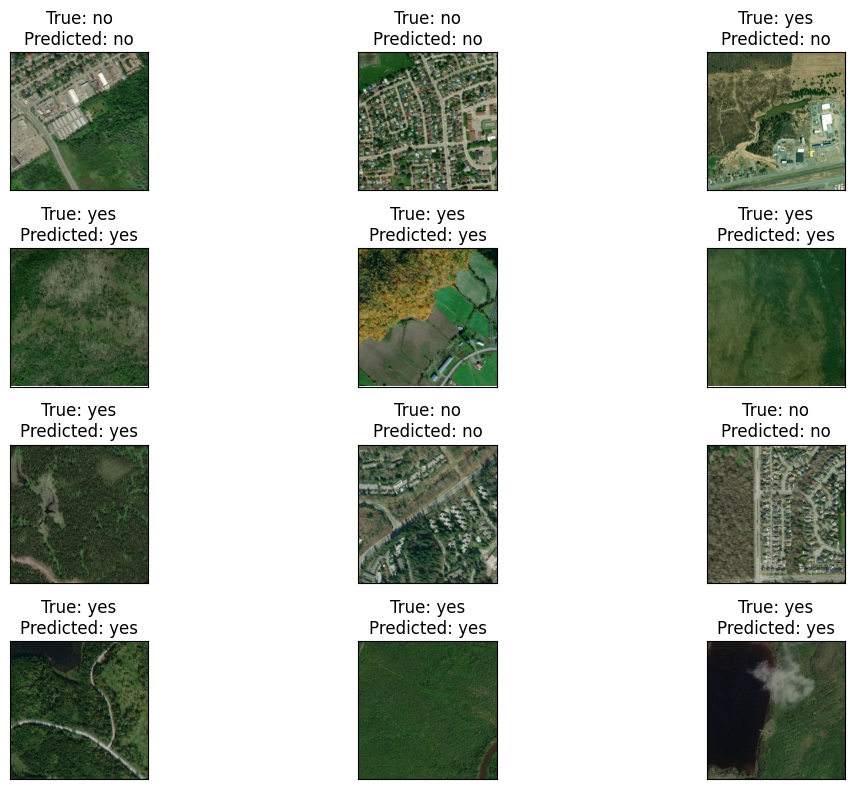

    Test Loss: 0.15475
Test Accuracy: 97.36%
##########################################
Found 27424 validated image filenames belonging to 2 classes.
Found 6856 validated image filenames belonging to 2 classes.
Found 8570 validated image filenames belonging to 2 classes.
Batch = 256
Epoch = 20
Epoch 1/20
108/108 [==============================] - 469s 4s/step - loss: 0.1467 - accuracy: 0.9436 - val_loss: 0.1174 - val_accuracy: 0.9536
Epoch 2/20
108/108 [==============================] - 462s 4s/step - loss: 0.0847 - accuracy: 0.9683 - val_loss: 0.0883 - val_accuracy: 0.9666
Epoch 3/20
108/108 [==============================] - 466s 4s/step - loss: 0.0622 - accuracy: 0.9764 - val_loss: 0.0797 - val_accuracy: 0.9704
Epoch 4/20
108/108 [==============================] - 466s 4s/step - loss: 0.0490 - accuracy: 0.9826 - val_loss: 0.0860 - val_accuracy: 0.9710
Epoch 5/20
108/108 [==============================] - 467s 4s/step - loss: 0.0325 - accuracy: 0.9881 - val_loss: 0.0930 - val_accurac

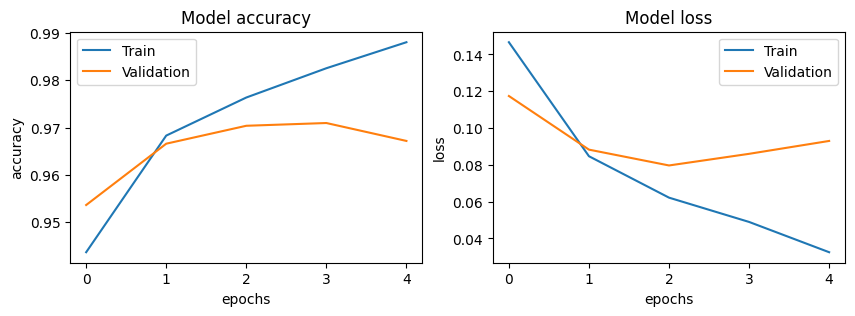

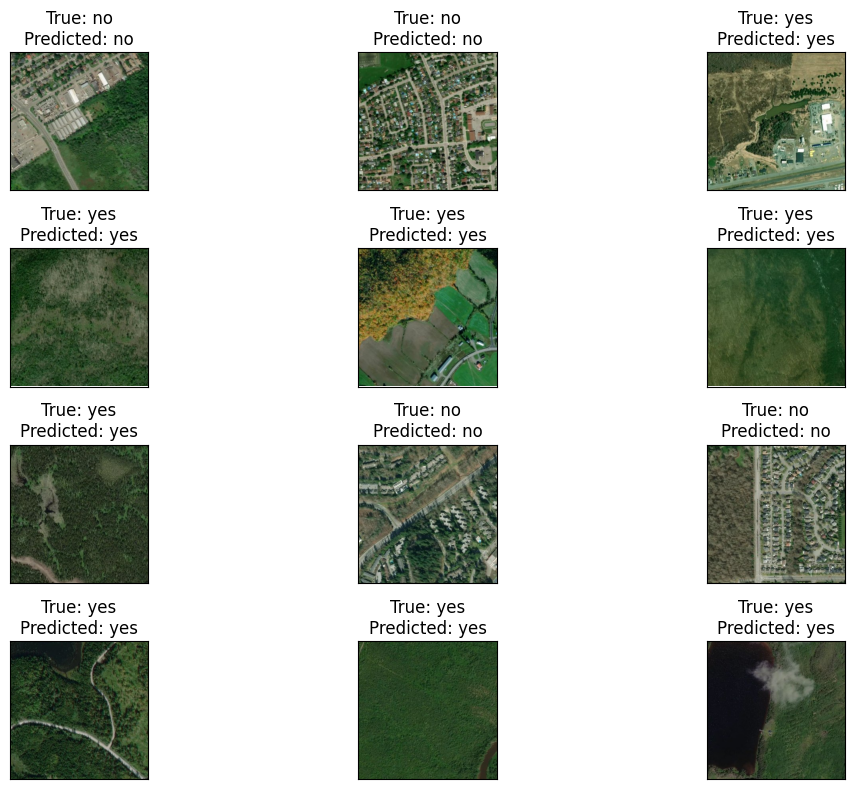

    Test Loss: 0.08158
Test Accuracy: 97.11%
##########################################
Batch = 256
Epoch = 50
Epoch 1/50
108/108 [==============================] - 461s 4s/step - loss: 0.0262 - accuracy: 0.9908 - val_loss: 0.0843 - val_accuracy: 0.9710
Epoch 2/50
108/108 [==============================] - 467s 4s/step - loss: 0.0165 - accuracy: 0.9942 - val_loss: 0.1169 - val_accuracy: 0.9660
Epoch 3/50
108/108 [==============================] - 464s 4s/step - loss: 0.0110 - accuracy: 0.9969 - val_loss: 0.1059 - val_accuracy: 0.9729
Model CNN enregistré avec les paramètres : batchs= 256 epochs= 50
##########################################
Batch = 256
Epoch = 50
Temps d'entrainement = ('0.38655484947893354', 'heures')
34/34 [==============================] - 116s 3s/step
              precision    recall  f1-score   support

          no       0.97      0.97      0.97      4028
         yes       0.97      0.97      0.97      4542

    accuracy                           0.97      8570

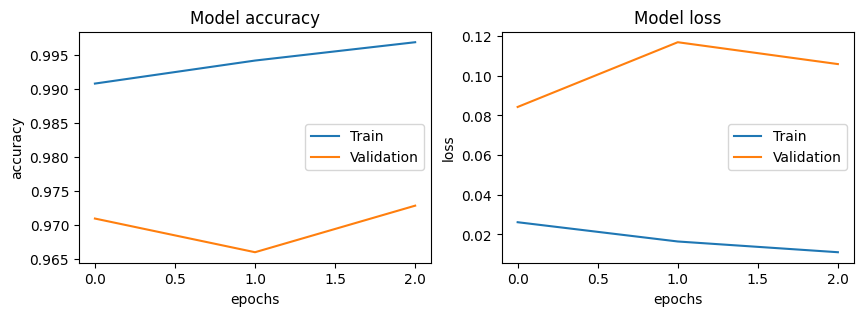

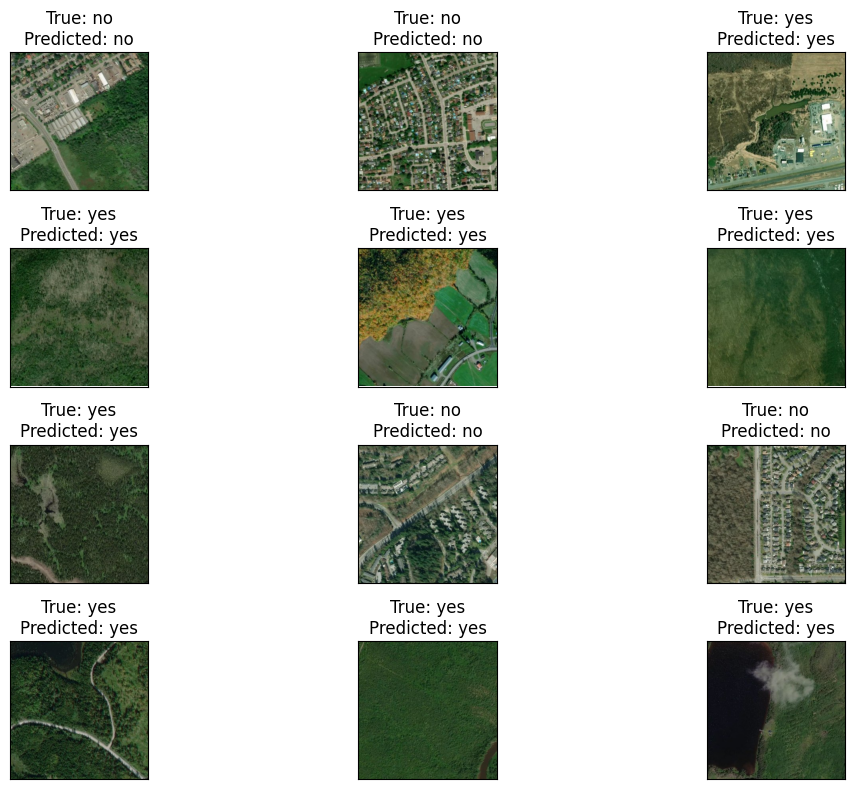

    Test Loss: 0.09416
Test Accuracy: 97.20%
##########################################
Batch = 256
Epoch = 100
Epoch 1/100
108/108 [==============================] - 461s 4s/step - loss: 0.0073 - accuracy: 0.9976 - val_loss: 0.1123 - val_accuracy: 0.9743
Epoch 2/100
108/108 [==============================] - 467s 4s/step - loss: 0.0055 - accuracy: 0.9984 - val_loss: 0.1236 - val_accuracy: 0.9729
Epoch 3/100
108/108 [==============================] - 464s 4s/step - loss: 0.0020 - accuracy: 0.9998 - val_loss: 0.1403 - val_accuracy: 0.9718
Model CNN enregistré avec les paramètres : batchs= 256 epochs= 100
##########################################
Batch = 256
Epoch = 100
Temps d'entrainement = ('0.38674462364779577', 'heures')
34/34 [==============================] - 116s 3s/step
              precision    recall  f1-score   support

          no       0.97      0.98      0.97      4028
         yes       0.98      0.97      0.98      4542

    accuracy                           0.97    

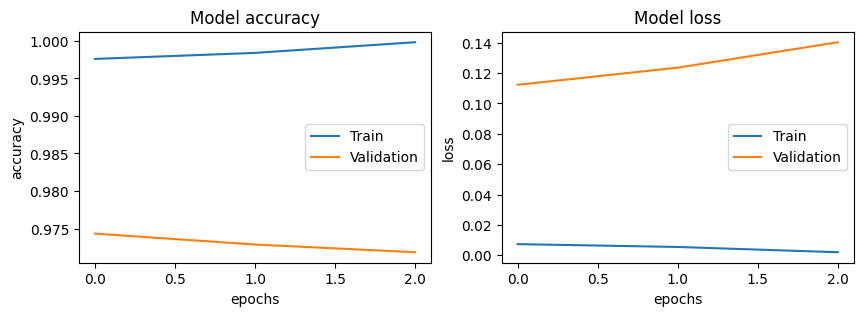

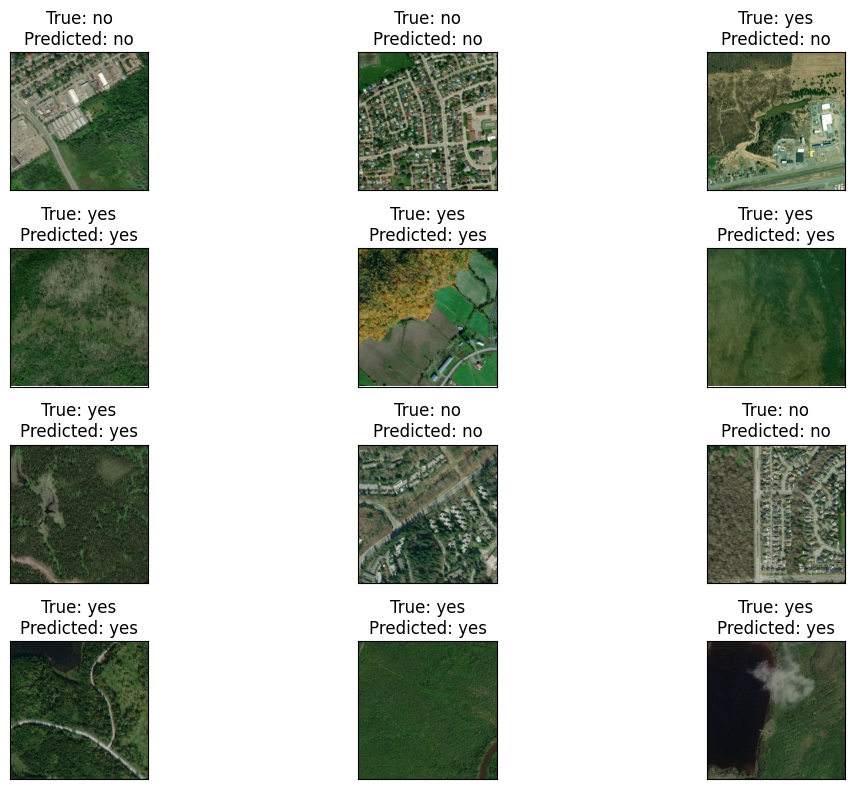

    Test Loss: 0.11977
Test Accuracy: 97.41%
##########################################
Batch = 256
Epoch = 200
Epoch 1/200
108/108 [==============================] - 464s 4s/step - loss: 0.0032 - accuracy: 0.9991 - val_loss: 0.2144 - val_accuracy: 0.9637
Epoch 2/200
108/108 [==============================] - 464s 4s/step - loss: 0.0182 - accuracy: 0.9934 - val_loss: 0.1391 - val_accuracy: 0.9681
Epoch 3/200
108/108 [==============================] - 463s 4s/step - loss: 0.0180 - accuracy: 0.9936 - val_loss: 0.1329 - val_accuracy: 0.9679
Epoch 4/200
108/108 [==============================] - 460s 4s/step - loss: 0.0116 - accuracy: 0.9961 - val_loss: 0.1365 - val_accuracy: 0.9716
Epoch 5/200
108/108 [==============================] - 463s 4s/step - loss: 0.0032 - accuracy: 0.9991 - val_loss: 0.1358 - val_accuracy: 0.9735
Model CNN enregistré avec les paramètres : batchs= 256 epochs= 200
##########################################
Batch = 256
Epoch = 200
Temps d'entrainement = ('0.6428898

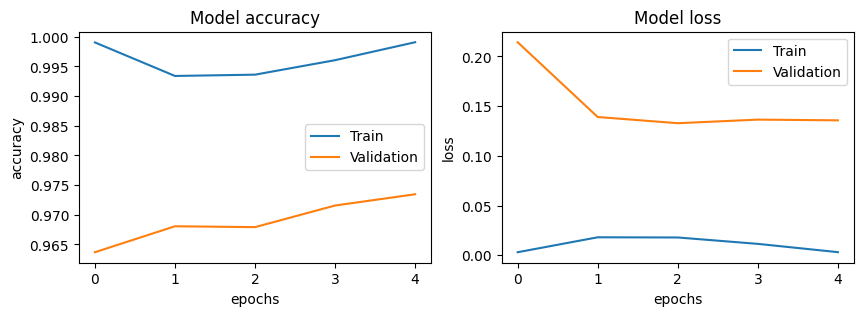

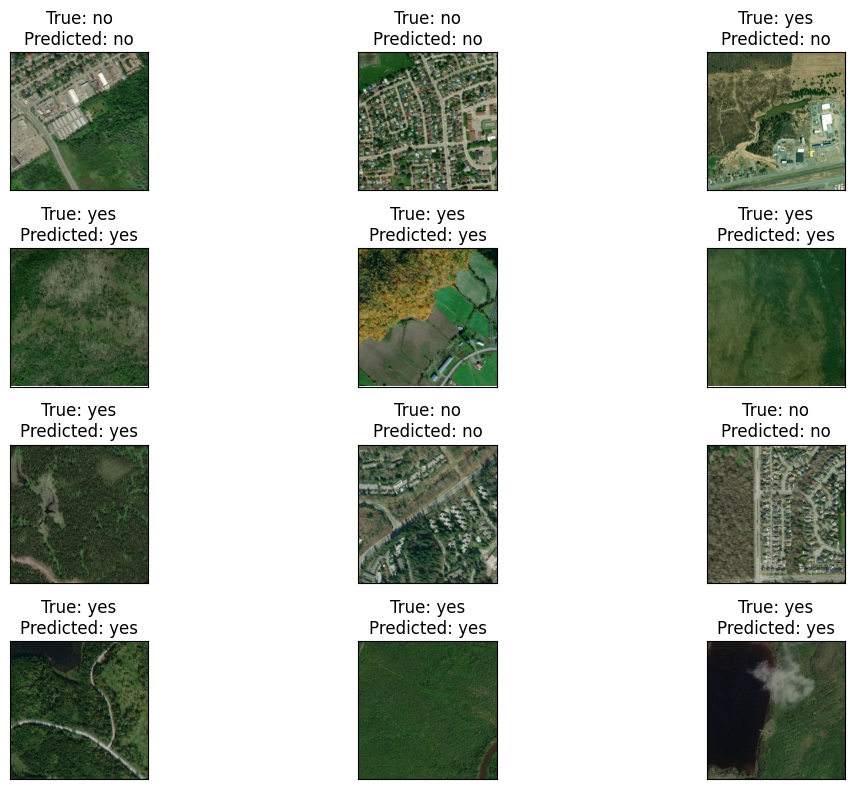

    Test Loss: 0.12676
Test Accuracy: 97.32%
##########################################


In [54]:
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.applications.resnet50 import preprocess_input
ResNet_pre=preprocess_input

for batchs in list_num_batchs_Resnet50 :
    train_gen_ResNet, valid_gen_ResNet, test_gen_ResNet = gen2(ResNet_pre,train_df,test_df, batchs)
    ResNet_model, callback=func(ResNet50)

    for epochs in list_num_epochs_Resnet50 :
        print("Batch =", batchs)
        print("Epoch =", epochs)
        start = time.time()
        history = ResNet_model.fit(
            train_gen_ResNet,
            validation_data=valid_gen_ResNet,
            epochs=epochs,
            callbacks=callback,
            verbose=1
        )
        end = time.time()
        
        ResNet_model.save(f'./modeles/CNN_opt/Resnet50_fire_120_120_opt_b{batchs}_e{epochs}.h5')
        print("Model CNN enregistré avec les paramètres : batchs=",batchs, "epochs=", epochs)
        
        print("##########################################")
        print("Batch =", batchs)
        print("Epoch =", epochs)
        print("Temps d'entrainement =",(format(((end-start)/60)/60),"heures"))
        history_ResNet= plot(history,test_gen_ResNet,train_gen_ResNet, ResNet_model)
        result_ResNet = result_test(test_gen_ResNet,ResNet_model)
        print("##########################################")

### ✔️ 5.4.2 Sauvegarde du meilleur modèle et test de prédiction

In [90]:
#Le dernier modèle ViT est le plus performant donc pas besoin de tout refaire tourner (presque 15h de fit)
model_ViT_opt.save('./modeles/fire_detection_120_120/ViT_fire_120_120_b300_e200.h5')
print('Model ViT enregistré!')

Model ViT enregistré!


In [20]:
#Chargement du modèle
bestModel=load_model('./modeles/fire_detection_120_120/ViT_fire_120_120_b300_e200.h5', custom_objects={'Patches': Patches,'PatchEncoder': PatchEncoder})
#bestModel=load_model('./modeles/fire_detection_120_120/SimpleCNN_fire_120_120.h5')
#bestModel.summary()
results = bestModel.evaluate(x_test, y_test)
print('Le modèle atteint un niveau de précision de {}%!'.format(round(results[1]*100,2)))

268/268 [==============================] - 21s 73ms/step - loss: 0.0700 - accuracy: 0.9798 - top-5-accuracy: 1.0000
Le modèle atteint un niveau de précision de 97.98%!


In [145]:
def fct_prediction(x_test, y_test, model):
    
    j=randint(0,len(y_test)-1)
    img = np.expand_dims(x_test[j], axis=0)
    #j=762
    if y_test[j]==0:
        print("Il n'y a pas de risque d'incendie sur la zone suivante :")
    else :
        print("Il y a risque d'incendie sur la zone suivante")
        
    plt.figure(figsize= (3,3))
    plt.imshow(x_test[j])
    
    
    prediction=model.predict(img)
    pred=np.argmax(prediction)
    if pred==1:
        print("Le modèle ViT prédit un risque d'incendie dans cette zone")
    else :
        print("Le modèle ViT ne prédit pas un risque d'incendie dans cette zone")
    
    if pred==y_test[j]:
        print("Prédiction OK")
    else :
        print("Prédiction NOK")
        
    return j

Il n'y a pas de risque d'incendie sur la zone suivante :
1/1 [==============================] - 0s 31ms/step
Le modèle ViT ne prédit pas un risque d'incendie dans cette zone
Prédiction OK


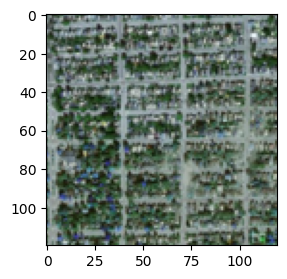

In [215]:
j=fct_prediction(x_test, y_test, bestModel)#  J est le numéro d'indexe de l'image

1/1 [==============================] - 0s 121ms/step


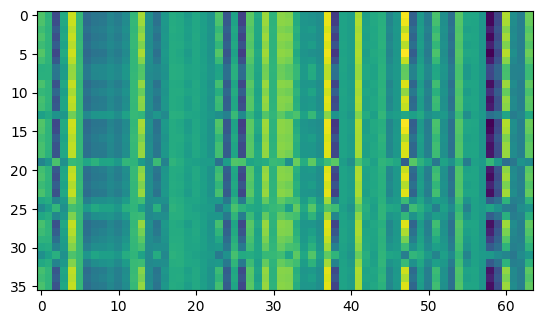

In [216]:
'''Récupération de la sortie de la première tête d'attention'''
# Chargement de l'image
input_image =x_test[j]

# Custom_model va me permettre de récupérer la sortie souhaitée 
attention_layer_name ='multi_head_attention_40'# Récupération de la sortie de la première tête d'attention
custom_model = tf.keras.Model(inputs=model.input, outputs=bestModel.get_layer(attention_layer_name).output)

# Récupération de l'attention map de l'image chargé
attention_maps = custom_model.predict(tf.expand_dims(input_image, axis=0))

# Visualisation de l'attention map
plt.imshow(attention_maps[0, :, :]) 
#cax = plt.axes([1, 0.1, 0.075, 0.8])
#plt.colorbar(cax=cax)
plt.show()

1/1 [==============================] - 1s 1s/step


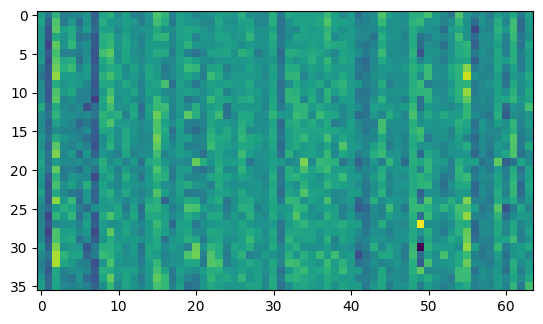

In [217]:
'''Récupération du rassemblement de toutes les têtes d'Attention'''
# Chargement de l'image
input_image =x_test[j]

# Custom_model va me permettre de récupérer la sortie souhaitée 
attention_layer_name ='layer_normalization_101'#A ce niveau, toutes les têtes d'attention sont prise en compte
custom_model = tf.keras.Model(inputs=model.input, outputs=bestModel.get_layer(attention_layer_name).output)

# Récupération de l'attention map de l'image chargé
attention_maps = custom_model.predict(tf.expand_dims(input_image, axis=0))

# Visualisation de l'attention map
plt.imshow(attention_maps[0, :, :]) 
#cax = plt.axes([1, 0.1, 0.075, 0.8])
#plt.colorbar(cax=cax)
plt.show()

In [38]:
bestModel.summary()

Model: "model_14"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_15 (InputLayer)       [(None, 120, 120, 3)]        0         []                            
                                                                                                  
 data_augmentation (Sequent  (None, 120, 120, 3)          7         ['input_15[0][0]']            
 ial)                                                                                             
                                                                                                  
 patches (Patches)           (None, None, 1200)           0         ['data_augmentation[0][0]']   
                                                                                                  
 patch_encoder (PatchEncode  (None, 36, 64)               79168     ['patches[0][0]']      

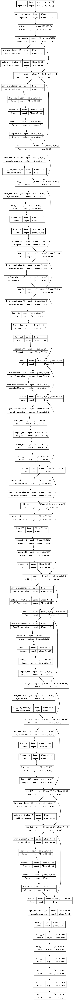

In [135]:
from tensorflow.keras.utils import plot_model
plot_model(bestModel, to_file='bestModel.png', show_shapes=True)

### ✔️ 5.4.3 : impact de la résolution sur le meilleur modèle

# FIN